In [1]:
!pip install PyWavelets

# Importar Paquetes

In [2]:
import pandas as pd
import pywt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
from scipy.fft import fft, fftfreq
from scipy.signal import find_peaks
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.utils import resample
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import base64
from io import BytesIO

# Cargar Datos

In [3]:
# Cargar los archivos

tsm_df = pd.read_excel("./Base de datos TSM consultoria estadística.xlsx")
chla_df = pd.read_excel("./Base de datos Chla consultoria estadística.xlsx")
coords_raw = pd.read_csv("./Coordenadas zona costera occidental GC.csv", header=None)

# Exploracion Inicial

In [4]:
tsm_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 447 entries, 0 to 446
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   ORDEN              446 non-null    float64       
 1   FECHA              446 non-null    datetime64[ns]
 2   AÑO                446 non-null    float64       
 3   MES                446 non-null    object        
 4   ESTACIÓN DEL AÑO   446 non-null    object        
 5   EVENTO INTERANUAL  446 non-null    object        
 6   Est 1°             446 non-null    float64       
 7   Est 2°             446 non-null    float64       
 8   Est 3°             446 non-null    float64       
 9   Est 4°             446 non-null    float64       
 10  Est 5°             446 non-null    float64       
 11  Est 6°             446 non-null    float64       
 12  Est 7°             446 non-null    float64       
 13  Est 8°             446 non-null    float64       
 14  Est 9°    

In [5]:
tsm_df.describe()

,ORDEN,FECHA,AÑO,Est 1°,Est 2°,Est 3°,Est 4°,Est 5°,Est 6°,Est 7°,Est 8°,Est 9°,Est 10°,Est 11°,Est 12°,Est 13°,Est 14°,Est 15°,Est 16°,Est 17°
count,446.000000,446,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000,446.000000
mean,223.500000,2000-03-16 18:30:40.358744448,1999.748879,26.215233,26.020798,25.700359,25.295146,25.348769,25.092540,24.877684,24.493221,24.331783,23.876132,23.361319,22.306692,22.348910,22.760935,23.432052,23.500504,23.816184
min,1.000000,1981-09-01 00:00:00,1981.000000,18.258300,17.575000,18.016700,14.433300,16.300000,15.391700,16.233300,12.833300,14.750000,13.183300,14.500000,10.368800,12.908300,12.616700,11.408300,14.850000,14.883300
25%,112.250000,1990-12-08 18:00:00,1990.250000,23.018725,22.827900,22.411375,21.977075,21.827075,21.409025,20.877775,20.100750,20.077075,19.329050,18.754450,17.854675,17.833725,17.570850,18.891700,18.712475,18.832225
50%,223.500000,2000-03-16 12:00:00,2000.000000,26.331400,26.408050,25.789200,25.431400,25.435000,25.262500,24.965250,24.704150,24.287500,23.695850,22.874150,21.496900,21.800000,22.138350,23.212500,23.116400,23.567500
75%,334.750000,2009-06-23 12:00:00,2009.000000,29.709900,29.599575,29.291700,28.965450,29.212075,29.033175,29.038050,28.904150,28.862950,28.652475,28.381225,27.262150,27.137525,27.872925,28.413900,28.480800,29.064550
max,446.000000,2018-10-01 00:00:00,2018.000000,32.241700,32.200000,32.239400,32.147200,32.429500,32.403900,32.172200,32.217800,32.283300,31.859400,31.416700,31.931300,30.683300,39.300000,32.325000,32.261100,32.631700
std,128.893367,NaN,10.745668,3.552104,3.656562,3.711975,3.772198,3.962083,4.175631,4.372093,4.703238,4.678021,4.954750,5.050388,5.041044,4.954625,5.715260,5.061941,5.109119,5.237785


In [6]:
tsm_df.head()

,ORDEN,FECHA,AÑO,MES,ESTACIÓN DEL AÑO,EVENTO INTERANUAL,Est 1°,Est 2°,Est 3°,Est 4°,...,Est 8°,Est 9°,Est 10°,Est 11°,Est 12°,Est 13°,Est 14°,Est 15°,Est 16°,Est 17°
0,1.0,1981-09-01,1981.0,Septiembre,Otoño,Neutro,30.5000,30.5083,30.1833,30.3750,...,29.9750,27.6583,28.6250,29.1583,28.8750,26.9667,28.8083,30.7583,30.0917,30.4667
1,2.0,1981-10-01,1981.0,Octubre,Otoño,Neutro,28.3833,28.1833,28.2667,28.0500,...,25.4500,27.2750,26.2333,24.7750,25.4813,23.2250,25.9000,26.8500,26.9167,27.5000
2,3.0,1981-11-01,1981.0,Noviembre,Otoño,Neutro,26.7750,26.7667,26.8833,26.8583,...,20.6167,22.1000,20.5917,20.0667,17.7188,18.5417,15.2417,18.3417,21.2583,22.2083
3,4.0,1981-12-01,1981.0,Diciembre,Invierno,Neutro,24.0667,24.3250,22.8917,22.8417,...,16.2667,19.3000,16.9417,16.3167,11.4188,13.7333,13.5667,13.9917,17.4833,18.3083
4,5.0,1982-01-01,1982.0,Enero,Invierno,Neutro,21.0583,20.6833,20.5583,20.7333,...,12.9000,14.7500,13.1833,14.8583,10.3688,13.2417,13.3000,11.4083,15.9333,14.9000


In [7]:
chla_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 254 entries, 0 to 253
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   ORDEN              254 non-null    int64         
 1   FECHA              254 non-null    datetime64[ns]
 2   AÑO                254 non-null    int64         
 3   MES                254 non-null    object        
 4   ESTACIÓN DEL AÑO   254 non-null    object        
 5   EVENTO INTERANUAL  254 non-null    object        
 6   Est 1°             254 non-null    float64       
 7   Est 2°             254 non-null    float64       
 8   Est 3°             254 non-null    float64       
 9   Est 4°             254 non-null    float64       
 10  Est 5°             254 non-null    float64       
 11  Est 6°             254 non-null    float64       
 12  Est 7°             254 non-null    float64       
 13  Est 8°             254 non-null    float64       
 14  Est 9°    

In [8]:
chla_df.describe()

,ORDEN,FECHA,AÑO,Est 1°,Est 2°,Est 3°,Est 4°,Est 5°,Est 6°,Est 7°,Est 8°,Est 9°,Est 10°,Est 11°,Est 12°,Est 13°,Est 14°,Est 15°,Est 16°,Est 17°
count,254.00000,254,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000
mean,127.50000,2008-03-16 18:31:10.866141696,2007.748031,0.409410,0.485911,0.570204,0.791891,0.839678,0.930585,0.807453,0.821802,1.151743,1.353704,1.550120,2.341487,1.930828,1.449363,1.402819,1.834102,1.954616
min,1.00000,1997-09-01 00:00:00,1997.000000,0.109800,0.120500,0.153000,0.176100,0.155300,0.177400,0.163600,0.164400,0.250500,0.267700,0.298800,0.728200,0.678400,0.439100,0.258400,0.346200,0.524500
25%,64.25000,2002-12-08 18:00:00,2002.250000,0.191900,0.215700,0.283925,0.347700,0.340975,0.416525,0.330550,0.383200,0.590300,0.807600,0.941350,1.376575,1.195475,0.860975,0.706375,1.021825,1.306150
50%,127.50000,2008-03-16 12:00:00,2008.000000,0.276200,0.327600,0.439650,0.687100,0.699750,0.783650,0.735600,0.717250,0.984300,1.216000,1.357300,1.798400,1.582250,1.221550,1.184600,1.594100,1.799450
75%,190.75000,2013-06-23 12:00:00,2013.000000,0.541500,0.659375,0.765775,1.039175,1.024900,1.273400,1.105300,1.125125,1.463550,1.751850,1.955075,2.802725,2.313900,1.855800,1.710575,2.143000,2.289500
max,254.00000,2018-10-01 00:00:00,2018.000000,1.438500,2.218800,3.262400,2.910800,4.294900,3.497400,3.121400,3.263000,3.784200,5.858600,5.128100,9.067800,6.871300,6.970100,7.383000,8.139300,8.527800
std,73.46768,NaN,6.130296,0.297238,0.366888,0.396711,0.549020,0.691200,0.661985,0.554555,0.542986,0.700019,0.779083,0.830237,1.555169,1.146268,0.837153,1.048025,1.244504,1.070397


In [9]:
chla_df.head()

,ORDEN,FECHA,AÑO,MES,ESTACIÓN DEL AÑO,EVENTO INTERANUAL,Est 1°,Est 2°,Est 3°,Est 4°,...,Est 8°,Est 9°,Est 10°,Est 11°,Est 12°,Est 13°,Est 14°,Est 15°,Est 16°,Est 17°
0,1,1997-09-01,1997,Septiembre,Otoño,Niño,0.1351,0.1281,0.1808,0.2266,...,0.5426,0.7643,1.0835,1.0230,1.2773,1.4592,0.6393,0.7153,0.9540,0.8567
1,2,1997-10-01,1997,Octubre,Otoño,Niño,0.1281,0.1580,0.2165,0.2528,...,0.4720,0.4914,0.6826,0.8687,1.6470,1.3498,1.0666,0.9594,1.7220,2.1849
2,3,1997-11-01,1997,Noviembre,Otoño,Niño,0.2229,0.2907,0.3404,0.3641,...,0.7847,1.2401,1.2862,1.5959,1.9907,1.4808,1.2608,2.0418,1.3360,1.4306
3,4,1997-12-01,1997,Diciembre,Invierno,Niño,0.4121,0.3930,0.6597,0.7563,...,0.5972,0.6240,0.7224,0.7215,0.7974,0.8068,0.9105,1.5298,1.2723,1.3488
4,5,1998-01-01,1998,Enero,Invierno,Niño,0.4254,0.5376,0.7848,0.6495,...,1.0542,1.1530,0.9157,0.7955,1.4840,1.0542,0.8114,0.8770,1.1915,3.3765


In [10]:
coords_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17 entries, 0 to 16
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       17 non-null     float64
 1   1       0 non-null      float64
 2   2       17 non-null     float64
dtypes: float64(3)
memory usage: 540.0 bytes


In [11]:
coords_raw.head()

,0,1,2
0,-109.3,NaN,23.8
1,-109.7,NaN,24.2
2,-110.1,NaN,24.6
3,-110.5,NaN,24.8
4,-110.8,NaN,25.3


# Reestructurar Datos

In [12]:
# Eliminar la columna ORDEN
chla_df = chla_df.drop(columns=["ORDEN"])
tsm_df = tsm_df.drop(columns=["ORDEN"])

In [13]:
coords_df = coords_raw[[0, 2]]
coords_df.columns = ["Longitud", "Latitud"]
coords_df["Estacion"] = range(1, len(coords_df)+1)

In [14]:
# Reestructurar ambos dataframes de formato ancho a largo (long format)

# Primero para TSM
tsm_df = tsm_df.iloc[:-1] # Hay q verificar si la base de datos para tsm tiene la ultima fila nula
tsm_long = tsm_df.melt(
    id_vars=["FECHA", "AÑO", "MES", "ESTACIÓN DEL AÑO", "EVENTO INTERANUAL"],
    var_name="Estacion",
    value_name="TSM"
)

# Limpiar nombres de estación
tsm_long["Estacion"] = tsm_long["Estacion"].str.replace("Est ", "").str.replace("°", "").str.strip()

# Luego para Chl a
chla_long = chla_df.melt(
    id_vars=["FECHA", "AÑO", "MES", "ESTACIÓN DEL AÑO", "EVENTO INTERANUAL"],
    var_name="Estacion",
    value_name="Chla"
)
chla_long["Estacion"] = chla_long["Estacion"].str.replace("Est ", "").str.replace("°", "").str.strip()

# Convertir tipo de datos de las columnas
tsm_long["Estacion"] = tsm_long["Estacion"].astype(int)
tsm_long["AÑO"] = tsm_long["AÑO"].fillna(-1).astype(int)



chla_long["Estacion"] = chla_long["Estacion"].astype(int)
chla_long["AÑO"] = chla_long["AÑO"].astype(int)

In [15]:
tsm_long.head()

,FECHA,AÑO,MES,ESTACIÓN DEL AÑO,EVENTO INTERANUAL,Estacion,TSM
0,1981-09-01,1981,Septiembre,Otoño,Neutro,1,30.5000
1,1981-10-01,1981,Octubre,Otoño,Neutro,1,28.3833
2,1981-11-01,1981,Noviembre,Otoño,Neutro,1,26.7750
3,1981-12-01,1981,Diciembre,Invierno,Neutro,1,24.0667
4,1982-01-01,1982,Enero,Invierno,Neutro,1,21.0583


In [16]:
chla_long.head()

,FECHA,AÑO,MES,ESTACIÓN DEL AÑO,EVENTO INTERANUAL,Estacion,Chla
0,1997-09-01,1997,Septiembre,Otoño,Niño,1,0.1351
1,1997-10-01,1997,Octubre,Otoño,Niño,1,0.1281
2,1997-11-01,1997,Noviembre,Otoño,Niño,1,0.2229
3,1997-12-01,1997,Diciembre,Invierno,Niño,1,0.4121
4,1998-01-01,1998,Enero,Invierno,Niño,1,0.4254


In [17]:
# Integrar coordenadas geográficas a los datos largos de TSM y Chla
tsm_geo = pd.merge(tsm_long, coords_df, on="Estacion", how="left")
chla_geo = pd.merge(chla_long, coords_df, on="Estacion", how="left")

In [44]:
tsm_long.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7582 entries, 0 to 7581
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   FECHA              7582 non-null   datetime64[ns]
 1   AÑO                7582 non-null   int64         
 2   MES                7582 non-null   object        
 3   ESTACIÓN DEL AÑO   7582 non-null   object        
 4   EVENTO INTERANUAL  7582 non-null   object        
 5   Estacion           7582 non-null   int64         
 6   TSM                7582 non-null   float64       
 7   Mes                7582 non-null   int32         
dtypes: datetime64[ns](1), float64(1), int32(1), int64(2), object(3)
memory usage: 444.4+ KB


In [18]:
tsm_geo.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7582 entries, 0 to 7581
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   FECHA              7582 non-null   datetime64[ns]
 1   AÑO                7582 non-null   int64         
 2   MES                7582 non-null   object        
 3   ESTACIÓN DEL AÑO   7582 non-null   object        
 4   EVENTO INTERANUAL  7582 non-null   object        
 5   Estacion           7582 non-null   int64         
 6   TSM                7582 non-null   float64       
 7   Longitud           7582 non-null   float64       
 8   Latitud            7582 non-null   float64       
dtypes: datetime64[ns](1), float64(3), int64(2), object(3)
memory usage: 533.2+ KB


# Análisis

Se analisará la variabilidad temporal y frecuencias de TSM (1981-2018) y Chl a (1997-2018), así como el efecto interanual, intranual y estacional del ENSO en los niveles de Temperatura Superficial del Mar (TSM) y concentración de Clorofila a (Chl a)

Análisis sugerido:

* Descriptivo temporal: Media, desviación estándar, anomalías.
* Series de tiempo:
  * Descomposición STL (tendencia, estacionalidad, residuo).
  * Modelos ARIMA / SARIMA para dinámica temporal (predicciones).

* Análisis espectral / frecuencia dominante:
  * Transformada de Fourier (FFT).
  * Wavelet Analysis (análisis multi-escalar).
* Bootstrap: Estimar la incertidumbre de los promedios/anomalías.

### TSM

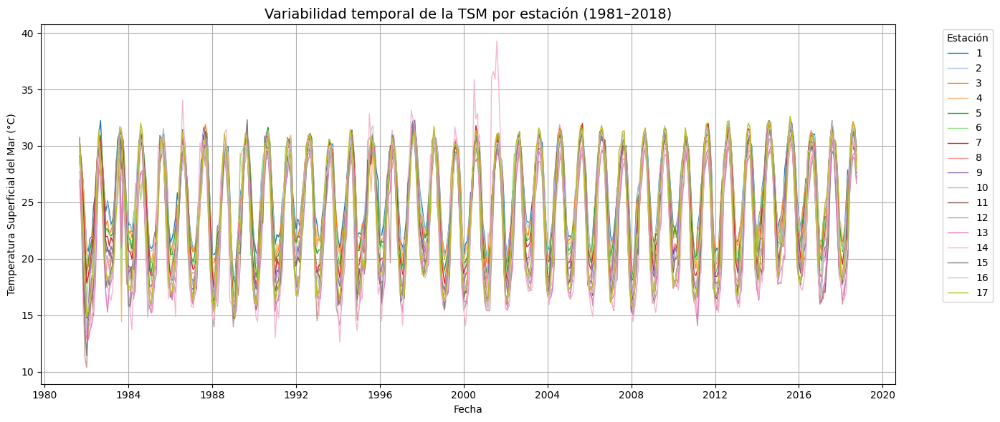

In [19]:
# Calcular el promedio mensual de TSM por estación
tsm_avg_by_station = tsm_geo.groupby(["FECHA", "Estacion"])["TSM"].mean().reset_index()

plt.figure(figsize=(14, 6))
sns.lineplot(data=tsm_avg_by_station, x="FECHA", y="TSM", hue="Estacion", palette="tab20", linewidth=1)
plt.title("Variabilidad temporal de la TSM por estación (1981–2018)", fontsize=14)
plt.xlabel("Fecha")
plt.ylabel("Temperatura Superficial del Mar (°C)")
plt.legend(title="Estación", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(True)
plt.show()

#### Análisis de frecuencia - Transformada de Fourier (FFT)

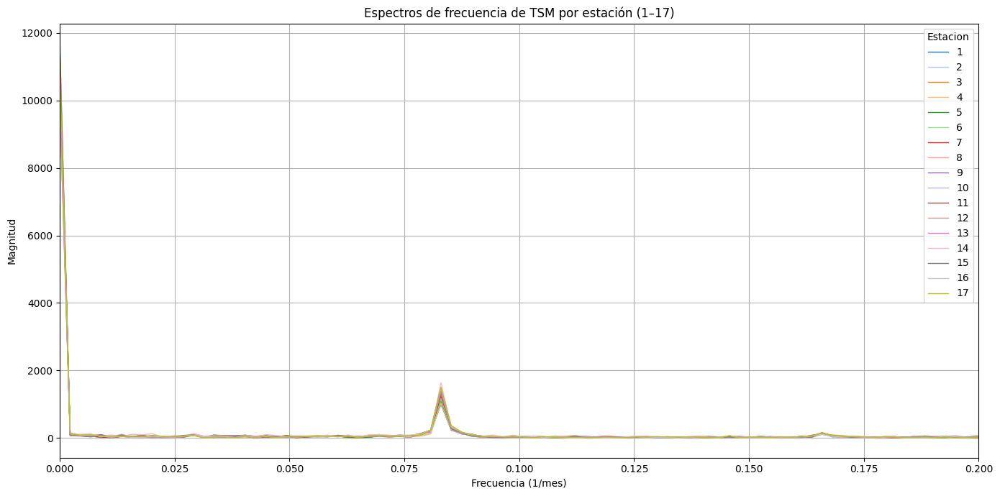

In [20]:
# Análisis de frecuencia para cada estación
fft_results = []

for est in range(1, 18):
    sub_df = tsm_geo[tsm_geo["Estacion"] == est].sort_values("FECHA")
    sub_series = sub_df["TSM"].dropna().values
    n = len(sub_series)
    if n > 0:
        freqs = fftfreq(n, d=1)
        fft_vals = fft(sub_series)
        pos_freqs = freqs[:n // 2]
        pos_fft = np.abs(fft_vals[:n // 2])
        fft_results.append(pd.DataFrame({
            "Frecuencia": pos_freqs,
            "Magnitud": pos_fft,
            "Estacion": est
        }))

fft_df_all = pd.concat(fft_results, ignore_index=True)

plt.figure(figsize=(14, 7))
sns.lineplot(data=fft_df_all, x="Frecuencia", y="Magnitud", hue="Estacion", palette="tab20", lw=1)
plt.title("Espectros de frecuencia de TSM por estación (1–17)")
plt.xlabel("Frecuencia (1/mes)")
plt.ylabel("Magnitud")
plt.xlim(0, 0.2)
plt.grid(True)
plt.tight_layout()
plt.show()

**Ejes:**
* *Eje X (Frecuencia):* Indica la frecuencia en unidades de 1/mes (ciclos por mes). Un valor de 0.1 representa un ciclo que se repite cada 1/0.1 = 10 meses. Valores cercanos a 0 indican variaciones de muy largo plazo, mientras que valores más altos representan variaciones más rápidas o de ciclo más corto.
* *Eje Y (Magnitud):* Representa la amplitud o la fuerza de cada componente de frecuencia en la señal de la Temperatura Superficial del Mar (TSM) para cada estación. Un pico alto en una frecuencia específica para una estación indica que esa frecuencia contribuye de manera significativa a la variabilidad temporal de la TSM en esa estación.

**Interpretación del gráfico:**

Se pueden identificar varios patrones importantes:

* *Pico Dominante en Frecuencias Muy Bajas (Cercanas a 0):* Para todas las estaciones, se observa un pico muy alto en las frecuencias cercanas a 0.

  * **Interpretación:** Esto indica que la variabilidad de la TSM en todas las estaciones está dominada por cambios de muy largo plazo. Esto podría representar tendencias a largo plazo (calentamiento o enfriamiento sostenido durante el periodo analizado) o ciclos de muy baja frecuencia que abarcan varios años. La magnitud tan alta sugiere que esta es la componente más importante de la variabilidad de la TSM en la región estudiada.

* *Pico Significativo alrededor de 0.083 (1/mes):* Para muchas estaciones, se observa un pico notable alrededor de la frecuencia de 0.083 ciclos por mes.

  * **Cálculo del Periodo:** Un periodo correspondiente a una frecuencia de 0.083 ciclos/mes es aproximadamente 1/0.083 ≈ 12.05 meses.

  * **Interpretación:** Este pico sugiere una fuerte variabilidad anual (ciclo de aproximadamente 12 meses) en la TSM para estas estaciones. Esto es muy probablemente la señal de la estacionalidad, con las variaciones entre las temperaturas más cálidas y más frías a lo largo del año. La altura de este pico varía entre las estaciones, lo que indica que la intensidad de la señal anual es diferente en cada ubicación.

* *Otros Picos Menores:* Se pueden observar picos de menor magnitud en otras frecuencias para algunas estaciones (por ejemplo, alrededor de 0.166, que correspondería a un ciclo de unos 6 meses).

  * **Interpretación:** Estos picos indican la presencia de variabilidad con otros periodos, pero su contribución a la variabilidad total de la TSM es menor en comparación con la variabilidad de largo plazo y la anual. Podrían estar relacionados con otros ciclos climáticos o fenómenos regionales.

* *Variabilidad entre Estaciones:* Los espectros de frecuencia no son idénticos para todas las estaciones.

  * **Interpretación:** Esto sugiere que la naturaleza y la intensidad de la variabilidad temporal de la TSM difieren entre las distintas ubicaciones representadas por las estaciones. Algunas estaciones pueden tener una señal anual más pronunciada, mientras que otras pueden mostrar una mayor influencia de otras frecuencias.

**Resumen:**

Este gráfico revela que la variabilidad temporal de la TSM en la región estudiada (representada por las 17 estaciones) está caracterizada principalmente por:

  * Una fuerte componente de variabilidad de muy largo plazo, dominante en todas las estaciones.
  * Una significativa componente de variabilidad anual (estacionalidad) en muchas estaciones, con diferente intensidad según la ubicación.
  * Variaciones con otros periodos más cortos, pero con menor influencia general.
  * Diferencias notables en los espectros de frecuencia entre las distintas estaciones, lo que indica una variabilidad espacial en el comportamiento temporal de la TSM.

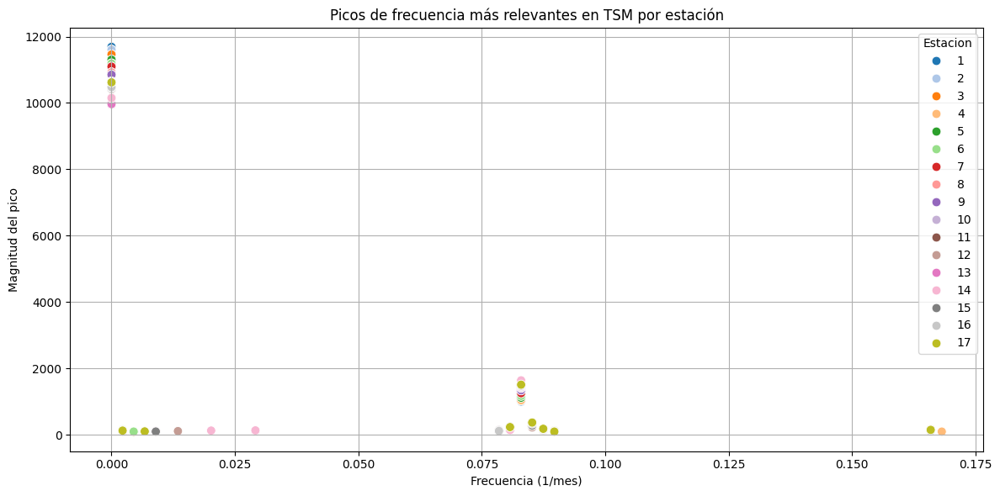

In [21]:
# Analizar los picos de frecuencia
peaks_data = []
n_top_peaks = 10

for est in range(1, 18):
    sub_df = tsm_geo[tsm_geo["Estacion"] == est].sort_values("FECHA")
    sub_series = sub_df["TSM"].dropna().values
    n = len(sub_series)
    if n > 0:
        freqs = fftfreq(n, d=1)
        fft_vals = fft(sub_series)
        pos_freqs = freqs[:n // 2]
        pos_fft = np.abs(fft_vals[:n // 2])

        all_freqs = np.concatenate(([0], pos_freqs))
        all_fft = np.concatenate(([np.abs(fft_vals[0])], pos_fft))

        # Encontrar los indices de los N picos más altos
        top_peak_indices = np.argsort(all_fft)[::-1][:n_top_peaks]

        for idx in top_peak_indices:
            peaks_data.append({
                "Estacion": est,
                "Frecuencia": all_freqs[idx],
                "Magnitud": all_fft[idx]
            })

peaks_df = pd.DataFrame(peaks_data)

plt.figure(figsize=(12, 6))
sns.scatterplot(data=peaks_df, x="Frecuencia", y="Magnitud", hue="Estacion", palette="tab20", s=60)
plt.title("Picos de frecuencia más relevantes en TSM por estación")
plt.xlabel("Frecuencia (1/mes)")
plt.ylabel("Magnitud del pico")
plt.grid(True)
plt.tight_layout()
plt.show()

**Ejes:**

* *Eje X (Frecuencia):* Al igual que en el gráfico anterior, indica la frecuencia en unidades de 1/mes (ciclos por mes).
* *Eje Y (Magnitud del pico):* Representa la amplitud o la fuerza del pico de frecuencia en el espectro de la TSM para cada estación. Un punto con una magnitud alta en una frecuencia específica indica que esa frecuencia tiene una contribución importante a la variabilidad de la TSM en esa estación.

**Interpretación del gráfico:**

Este gráfico se enfoca en los picos más importantes del espectro de frecuencia para cada estación, en lugar de mostrar el espectro completo. Cada punto representa una frecuencia donde la variabilidad de la TSM es particularmente fuerte para una estación específica. En específico se observan los 10 picos de frecuencia más relevantes por estación.

* *Picos Dominantes en Frecuencias Bajas (Cercanas a 0):* Para la mayoría de las estaciones, se observan picos con magnitudes relativamente altas en frecuencias muy cercanas a 0 (aunque no estén exactamente en 0 en este gráfico, los puntos más a la izquierda representan frecuencias bajas).

  * **Interpretación:** Esto refuerza la idea del gráfico anterior de que la variabilidad de largo plazo es una componente importante de la TSM en muchas estaciones. La altura de estos puntos indica la fuerza de esta variabilidad de baja frecuencia para cada estación. Podemos ver que algunas estaciones (identificables por su color) tienen picos de baja frecuencia mucho más altos que otras, lo que sugiere una mayor influencia de tendencias o ciclos de muy largo plazo en esas ubicaciones.

* *Picos alrededor de 0.083 (Variabilidad Anual):* Muchos puntos se agrupan alrededor de la frecuencia de 0.083 ciclos por mes (aproximadamente 12 meses o 1 año).

  * **Interpretación:** Esto confirma la presencia de una fuerte señal anual (estacionalidad) en la TSM para la mayoría de las estaciones. La magnitud de estos picos varía entre las estaciones, lo que indica diferencias en la intensidad de la variación anual de la temperatura del mar según la ubicación. Algunas estaciones muestran picos anuales mucho más pronunciados que otras.

* *Picos en Otras Frecuencias:* Se observan puntos en otras frecuencias a lo largo del eje X, aunque generalmente con magnitudes más bajas que los picos de baja frecuencia y los picos anuales.

  * **Interpretación:** Estos picos representan variabilidad de la TSM con otros periodos. Por ejemplo:
    * Alrededor de 0.166 (1/mes): Correspondería a un ciclo de aproximadamente 6 meses (semi-anual).
    * Frecuencias aún más altas representarían ciclos más cortos.
  * La presencia de estos picos varía entre las estaciones, sugiriendo que algunas ubicaciones experimentan variabilidad significativa en estas escalas de tiempo, mientras que otras no.

* *Variabilidad entre Estaciones (Picos Específicos):* Al observar los diferentes colores (estaciones), podemos ver que algunas estaciones tienen picos muy prominentes en ciertas frecuencias donde otras no los tienen, o los tienen con magnitudes mucho menores.

  * **Interpretación:** Esto subraya la heterogeneidad espacial en la variabilidad temporal de la TSM. Los procesos que influyen en la TSM pueden operar a diferentes escalas de tiempo y con diferente intensidad en distintas ubicaciones geográficas.

**Resumen:**

Este gráfico de picos de frecuencia proporciona una visión concisa de las escalas de tiempo más importantes de la variabilidad de la TSM para cada estación:

  * La **variabilidad de largo plazo (frecuencias bajas)** es una característica dominante en muchas estaciones.
  * La **variabilidad anual (alrededor de 0.083 1/mes)** es también muy importante y presente en la mayoría de las estaciones, aunque con diferente intensidad.
  * Otras escalas de tiempo de variabilidad (frecuencias más altas) existen, pero generalmente con menor magnitud y variando en su presencia e intensidad entre las estaciones.

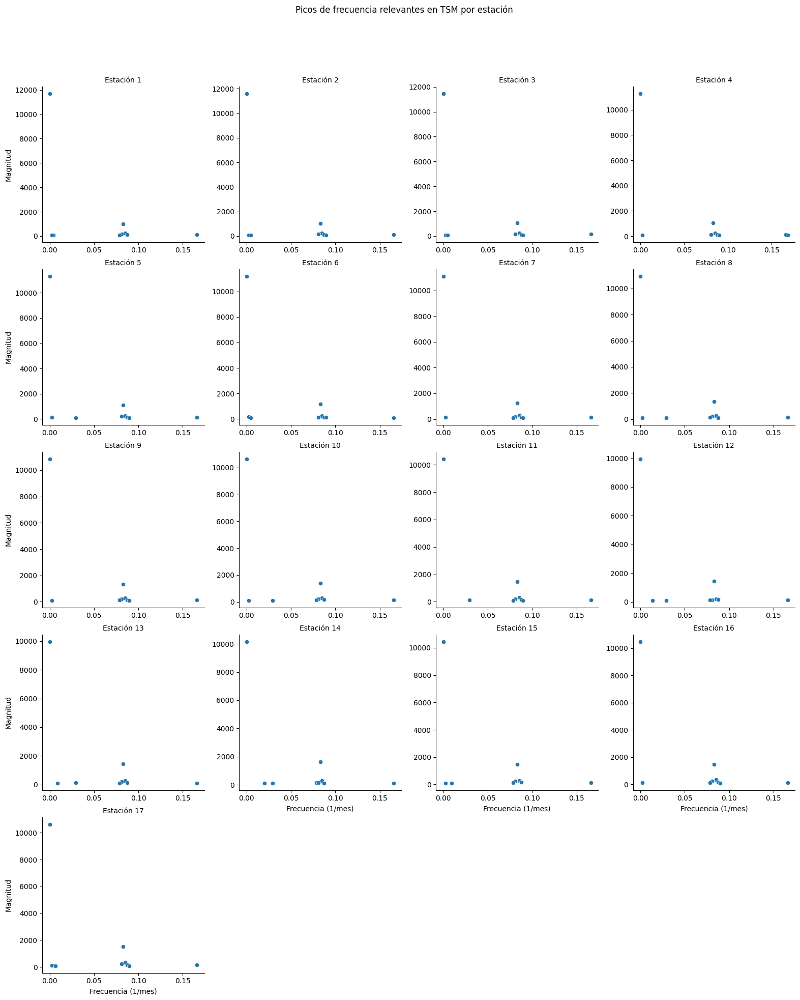

In [22]:
# Detectar picos de frecuencia más significativos por estación
peaks_data = []

for est in range(1, 18):
    peaks_data = []
n_top_peaks = 10

for est in range(1, 18):
    sub_df = tsm_geo[tsm_geo["Estacion"] == est].sort_values("FECHA")
    sub_series = sub_df["TSM"].dropna().values
    n = len(sub_series)
    if n > 0:
        freqs = fftfreq(n, d=1)
        fft_vals = fft(sub_series)
        pos_freqs = freqs[:n // 2]
        pos_fft = np.abs(fft_vals[:n // 2])

        all_freqs = np.concatenate(([0], pos_freqs))
        all_fft = np.concatenate(([np.abs(fft_vals[0])], pos_fft))

        # Encontrar los indices de los N picos más altos
        top_peak_indices = np.argsort(all_fft)[::-1][:n_top_peaks]

        for idx in top_peak_indices:
            peaks_data.append({
                "Estacion": est,
                "Frecuencia": all_freqs[idx],
                "Magnitud": all_fft[idx]
            })

peaks_df = pd.DataFrame(peaks_data)

g = sns.FacetGrid(peaks_df, col="Estacion", col_wrap=4, height=4, sharex=False, sharey=False)
g.map_dataframe(sns.scatterplot, x="Frecuencia", y="Magnitud")
g.set_titles("Estación {col_name}")
g.set_axis_labels("Frecuencia (1/mes)", "Magnitud")
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Picos de frecuencia relevantes en TSM por estación")
plt.show()

#### Análisis espectral (Análisis Wavelet)

<ipython-input-23-4a2e2dc7e3a4>:36: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.94])


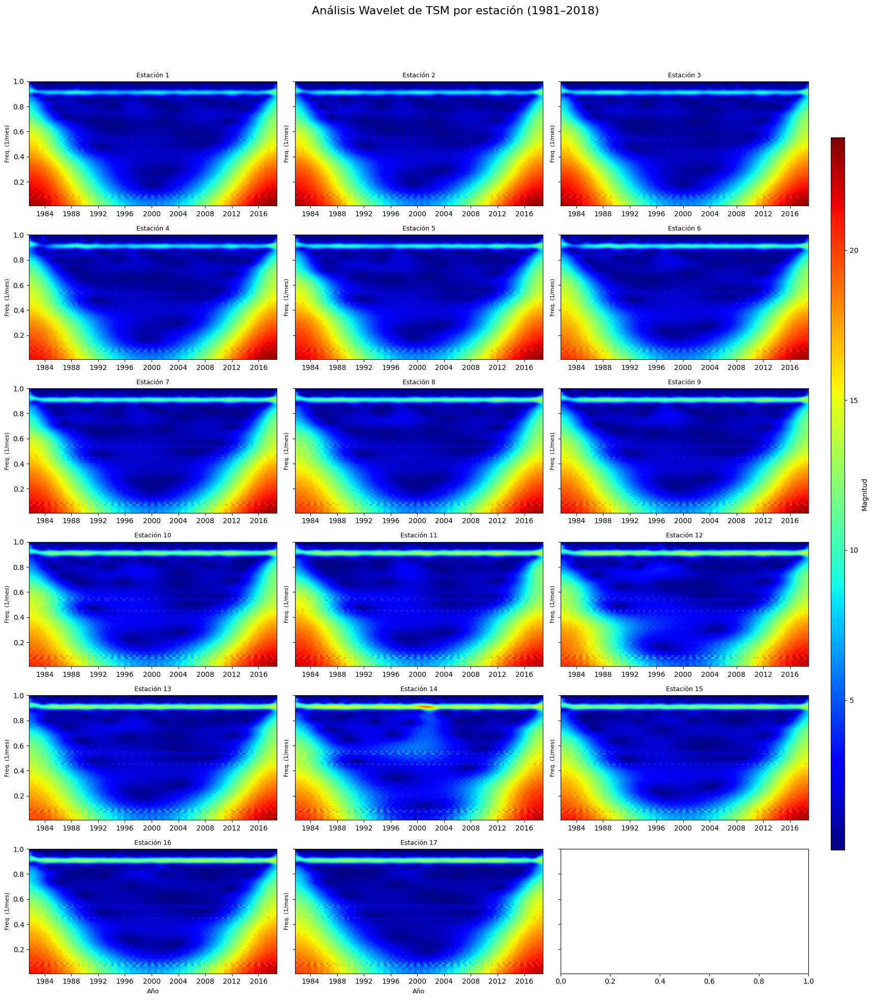

In [23]:
# Crear figura para los subplots
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(18, 20), sharey=True)
axes = axes.flatten()

# Escalas y configuración para wavelet
wavelet = 'cmor1.5-1.0'
scales = np.arange(1, 128)

# Generar wavelet para cada estación
for i, est in enumerate(range(1, 18)):
    sub_df = tsm_long[tsm_long["Estacion"] == est].sort_values("FECHA")
    sub_df = sub_df.dropna(subset=["TSM"])
    if not sub_df.empty:
        series = sub_df.set_index("FECHA")["TSM"]
        coef, freqs = pywt.cwt(series.values, scales, wavelet, sampling_period=1)

        # Convertir fechas a ordinales para eje X
        times = mdates.date2num(series.index.to_pydatetime())
        extent = [times[0], times[-1], freqs[-1], freqs[0]]

        ax = axes[i]
        im = ax.imshow(np.abs(coef), extent=extent, cmap='jet', aspect='auto')
        ax.set_title(f'Estación {est}', fontsize=9)
        ax.set_ylabel('Freq. (1/mes)', fontsize=8)
        ax.xaxis_date()
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        if i >= 15:
            ax.set_xlabel('Año', fontsize=9)

# Barra de color
fig.subplots_adjust(right=0.88, top=0.95)
cbar_ax = fig.add_axes([0.91, 0.15, 0.015, 0.7])
fig.colorbar(im, cax=cbar_ax, label="Magnitud")

fig.suptitle("Análisis Wavelet de TSM por estación (1981–2018)", fontsize=16)
plt.tight_layout(rect=[0, 0, 0.9, 0.94])
plt.show()

**Componentes del Gráfico:**

* *Eje X (Tiempo):* El eje horizontal en cada panel representa el tiempo, que en este caso abarca desde aproximadamente 1981 hasta 2018.
* *Eje Y (Periodo o Escala):* El eje vertical representa el periodo de las oscilaciones detectadas. Generalmente, la escala se muestra de forma logarítmica o pseudo-logarítmica, donde los valores más bajos están en la parte superior (periodos más cortos, como meses) y los valores más altos en la parte inferior (periodos más largos, como años). A veces, en lugar de periodo, se muestra la escala wavelet, que está directamente relacionada con el periodo.
* *Escala de Color (Magnitud o Potencia):* La barra de color a la derecha del gráfico general indica la magnitud o potencia de las oscilaciones en cada escala de tiempo para cada punto en el tiempo.
  * Colores cálidos (rojo, amarillo): Representan alta potencia o fuerte presencia de oscilaciones en esa escala de tiempo en ese momento específico.
  * Colores fríos (azul, verde): Representan baja potencia o débil presencia de oscilaciones.
* *Cono de Influencia (COI):* En muchos paneles, puedes ver áreas más claras o sombreadas en los bordes (especialmente al principio y al final del periodo). Esta es el "Cono de Influencia". Las señales dentro de esta región pueden estar afectadas por los bordes de la serie temporal, por lo que la interpretación debe ser cautelosa. La información más confiable se encuentra fuera del COI.

**Análisis Wavelet**

A diferencia del análisis de Fourier (que nos da las frecuencias dominantes en toda la serie temporal), el análisis wavelet te permite ver cómo las diferentes componentes de frecuencia (o periodo) varían en el tiempo. Es decir, puedes identificar cuándo ciertas oscilaciones fueron más fuertes o más débiles a lo largo de la serie temporal.

 aqui me quede

**Interpretación del Gráfico:**

* *Dominancia de la Variabilidad de Largo Plazo:* La característica más destacada en la variabilidad de la TSM para la mayoría de las estaciones durante el periodo 1981-2018 es la presencia de oscilaciones o tendencias de muy largo periodo (escala de varios años a décadas). Estas son las señales más fuertes en los datos y pueden estar relacionadas con la Oscilación Decadal del Pacífico (PDO).

* *Variabilidad Interanual Significativa:* Las zonas amarillas y anaranjadas que se extienden hacia la parte media de los paneles indican también una variabilidad interanual importante (periodos de 2 a 8 años, aproximadamente). Esto sugiere que fenómenos como El Niño-Oscilación del Sur (ENOS) y otras oscilaciones climáticas de escala de varios años tienen una influencia considerable en la TSM de estas estaciones.

* *Señal Anual (Periodos Cortos) Menos Dominante:* Aunque puede haber una ligera banda de colores más cálidos en la parte superior de algunos paneles (indicando la señal anual), no es la característica dominante en términos de potencia, en comparación con la variabilidad de largo plazo e interanual. Esto significa que, si bien la estacionalidad está presente, su impacto en la variabilidad total de la TSM, en términos de potencia espectral, es menor que las fluctuaciones de periodo más largo.

* *Variabilidad Espacial:* Aún se observa variabilidad entre las estaciones. La intensidad y la estructura de las zonas rojas y amarillas en la parte inferior y media varían entre los paneles, lo que indica que la naturaleza de la variabilidad de largo plazo e interanual no es uniforme en toda la región estudiada.

**Resumen:**

El análisis wavelet revela que la variabilidad temporal de la TSM en esta región durante 1981-2018 está dominada principalmente por oscilaciones y tendencias de largo plazo (escala de varios años a décadas), seguida por una variabilidad interanual significativa. La señal anual (estacionalidad) está presente, pero tiene una menor potencia relativa en comparación con las fluctuaciones de periodo más largo. Además, existen diferencias espaciales en estas características de variabilidad entre las distintas estaciones.


**La Oscilación Decadal del Pacífico (PDO) Vs El Niño-Oscilación del Sur (ENSO)**

La Oscilación Decadal del Pacífico (PDO) y El Niño-Oscilación del Sur (ENSO) son ambos patrones de variabilidad climática importantes en el Océano Pacífico, pero difieren en varias maneras clave:

1. *Escala de Tiempo:*

  * **ENSO:** Es principalmente un fenómeno interanual, lo que significa que sus fases (El Niño, La Niña y Neutral) típicamente duran de varios meses a un par de años, con un ciclo irregular que oscila entre 2 y 7 años.
  * **PDO:** Opera en una escala de tiempo mucho más larga, con fases cálidas y frías que suelen durar décadas (20-30 años, aunque puede variar).

2. *Ubicación Principal de las Anomalías de Temperatura Superficial del Mar (TSM):*

  * **ENSO:** Las anomalías de TSM más significativas se localizan en el Pacífico tropical, a lo largo del Ecuador. El Niño se caracteriza por aguas más cálidas de lo normal en el Pacífico tropical oriental y central, mientras que La Niña presenta aguas más frías en esa región.
  * **PDO:** Las anomalías de TSM más fuertes asociadas con la PDO se encuentran en el Pacífico Norte, aunque también se observan anomalías más débiles en el Pacífico tropical. En la fase cálida de la PDO, el Pacífico Norte oriental tiende a ser más cálido y el Pacífico tropical central y occidental más frío. En la fase fría, ocurre lo contrario.

3. *Patrones de Circulación Atmosférica Asociados:*

  * **ENSO:** Tiene impactos significativos en los patrones de viento y presión atmosférica en el Pacífico tropical (la "Oscilación del Sur"), lo que a su vez genera teleconexiones que afectan el clima en muchas partes del mundo.
  * **PDO:** Si bien también influye en los patrones atmosféricos, su conexión directa con la Oscilación del Sur no es tan pronunciada como en el caso del ENSO. **Se cree que la PDO puede ser influenciada por la acumulación de los efectos de eventos ENSO sucesivos** y por otros factores atmosféricos y oceánicos en el Pacífico Norte.

4. *Impactos Climáticos:*

  * **ENSO:** Tiene impactos climáticos bien documentados y a menudo predecibles a nivel regional y global en escalas de tiempo estacionales a interanuales, afectando las temperaturas, las precipitaciones, los patrones de tormentas y la productividad marina.
  * **PDO:** Sus impactos climáticos son más sutiles y se manifiestan en escalas de tiempo decenales, modulando las tendencias a largo plazo de las temperaturas y las precipitaciones regionales, así como la productividad de los ecosistemas marinos, especialmente en el Pacífico Norte y las regiones adyacentes. **La PDO también puede influir en la intensidad de los impactos del ENSO.**

*Ambos son patrones naturales de variabilidad climática y pueden interactuar entre sí, haciendo que los impactos climáticos en una región específica sean complejos y dependan de la fase de ambos fenómenos.*

**¿Por qué la PDO podría influir en la Variabilidad de Largo Plazo de la TSM en el estudio?**

  * *Escala de Tiempo:* La PDO opera en escalas de tiempo decenales (de 10 a 30 años por fase), lo que coincide con la variabilidad de "largo plazo" que se observa en la parte inferior de los gráficos de wavelet (que representan periodos largos).

  * *Conexión Pacífico-Global:* Aunque la PDO es un fenómeno del Pacífico Norte, tiene teleconexiones, lo que significa que puede influir en los patrones climáticos y las temperaturas del océano en otras partes del Pacífico.

  * *Modulación de ENSO:* Se sabe que la PDO puede modular la frecuencia e intensidad de los eventos El Niño y La Niña (ENSO). Por ejemplo, durante ciertas fases de la PDO, los eventos El Niño pueden ser más frecuentes o intensos. **Esta modulación a largo plazo de ENSO también podría contribuir a la variabilidad de largo plazo que se observa en los gráficos.**

  * *Procesos Oceánicos a Gran Escala:* La PDO está asociada con cambios en la circulación oceánica a gran escala en el Pacífico, lo que puede llevar a cambios persistentes en la distribución de la temperatura del agua.

#### Descomposición STL (Seasonal-Trend decomposition using Loess)

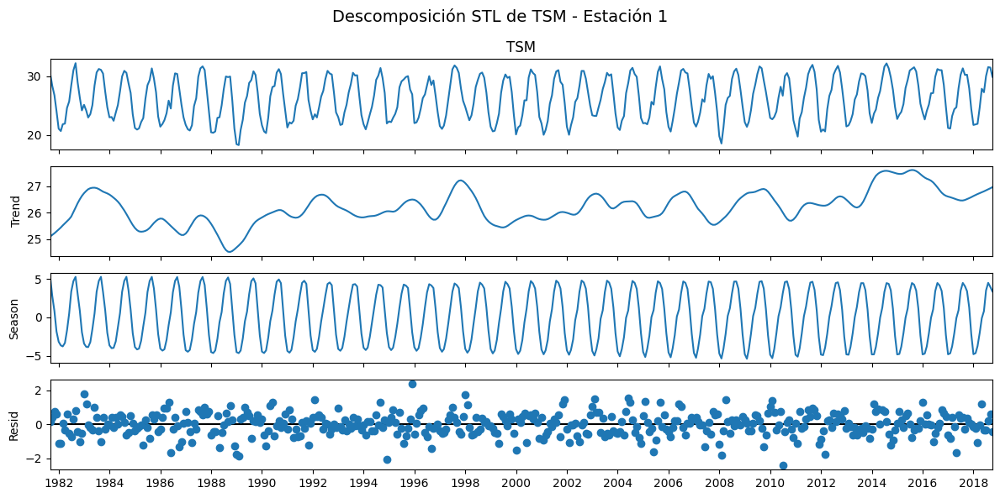

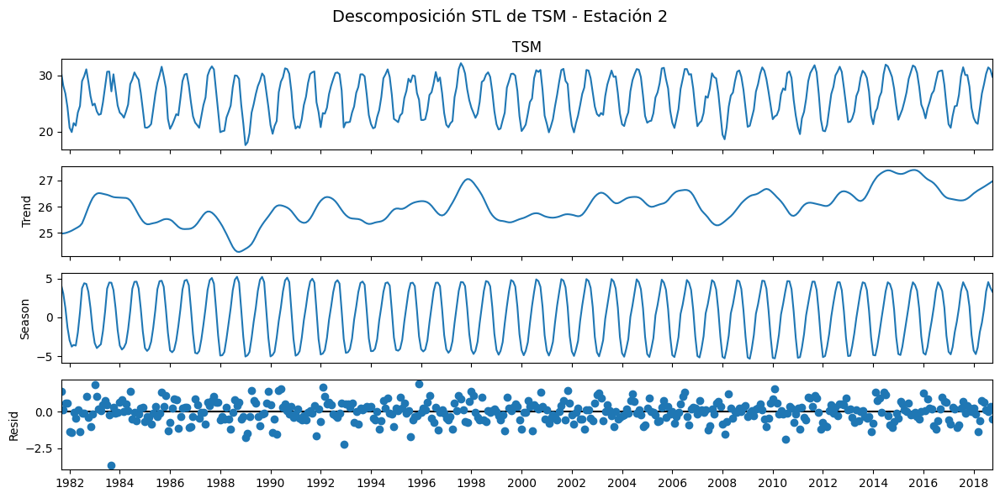

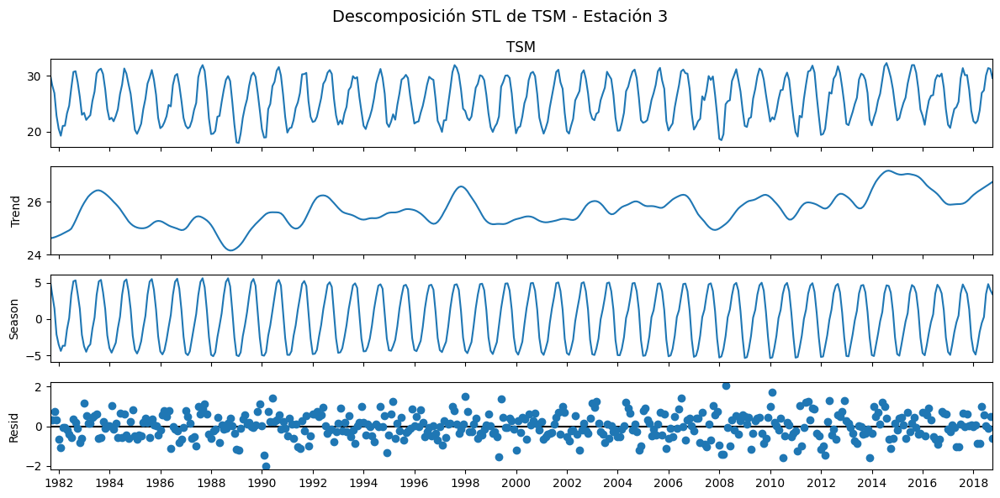

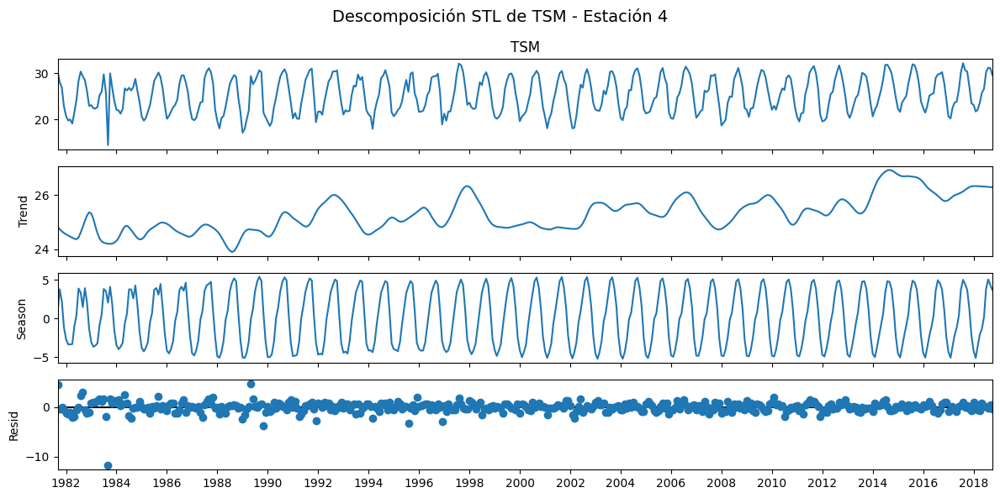

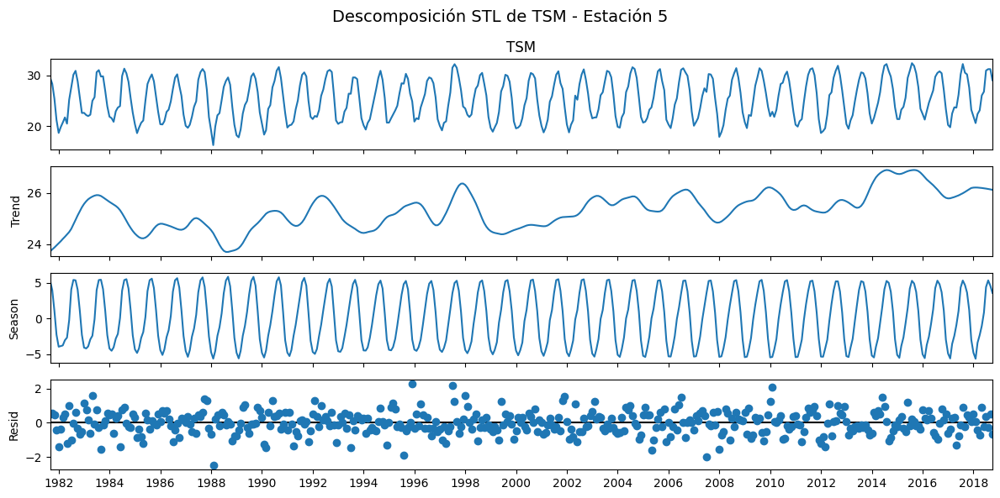

...

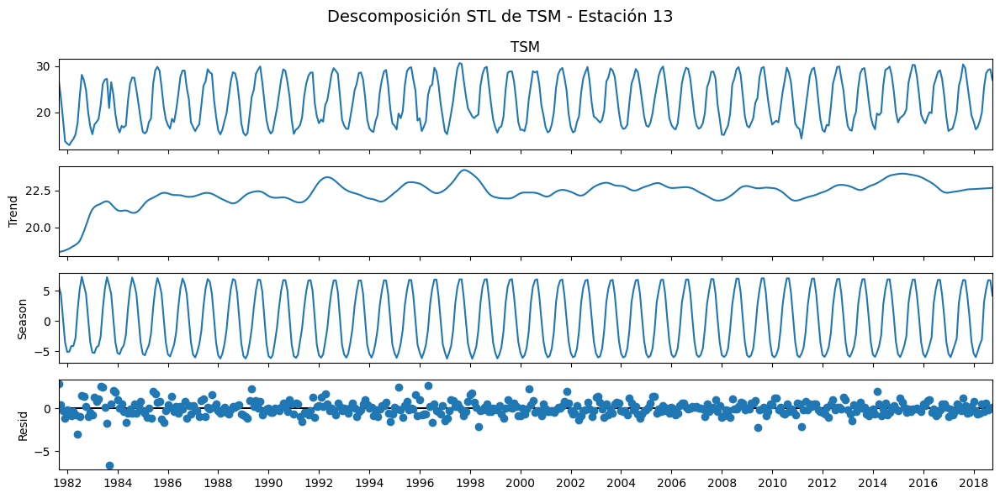

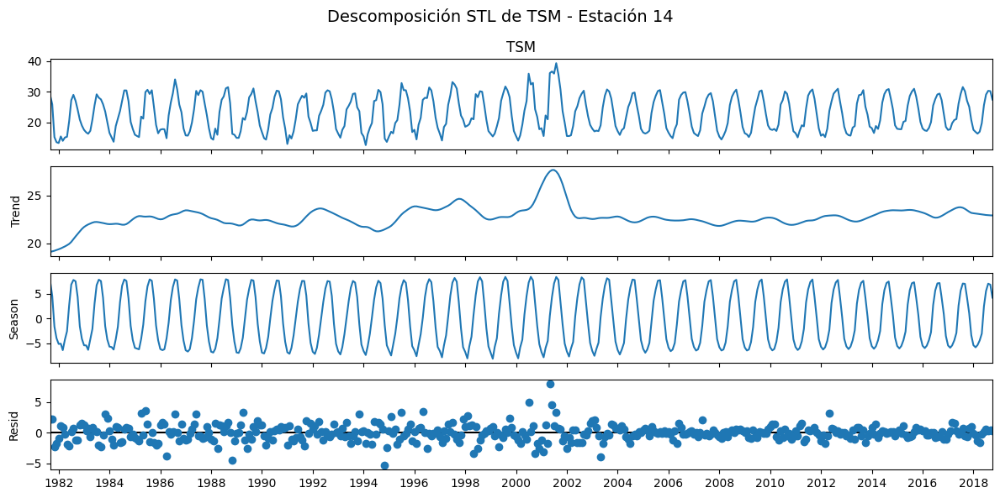

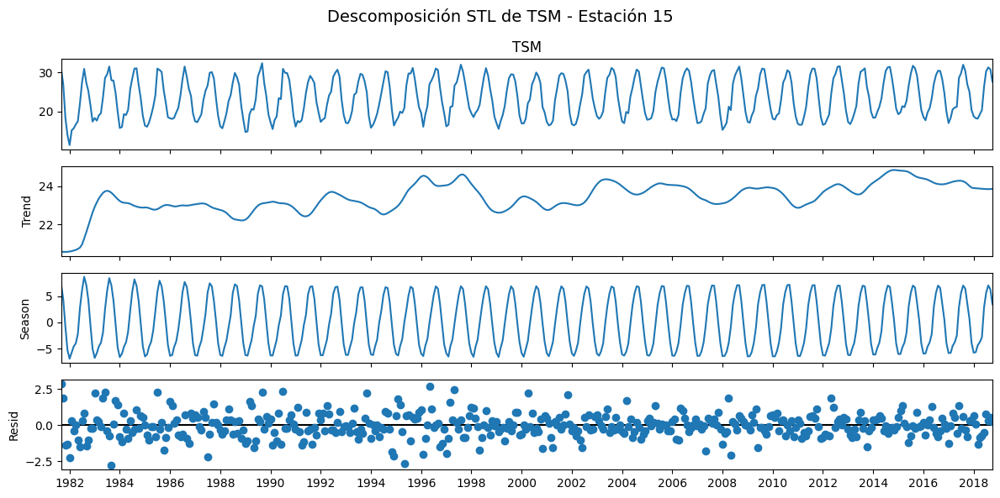

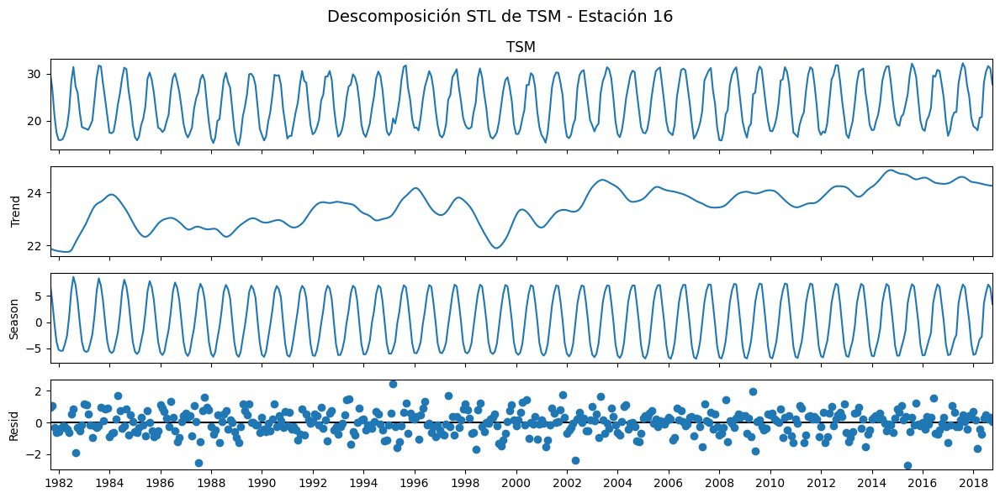

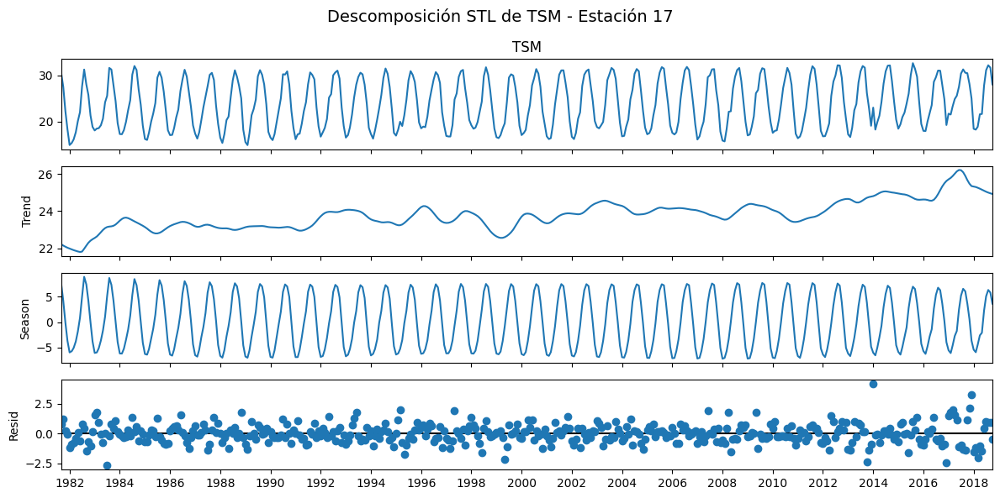

In [24]:
for i in range(1, 18):
  tsm_est = tsm_long[tsm_long["Estacion"] == i].sort_values("FECHA")
  tsm_est = tsm_est.dropna(subset=["TSM"])

  tsm_series = tsm_est.set_index("FECHA")["TSM"]

  # Aplicar STL
  stl = STL(tsm_series, period=12, seasonal=13)
  result = stl.fit()

  fig = result.plot()
  fig.set_size_inches(12, 6)

  ax = fig.gca()
  x_ticks = ax.get_xticks()

  x_ticks_dates = [mdates.num2date(tick) for tick in x_ticks]

  ax.xaxis.set_major_locator(mdates.YearLocator(2))
  ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

  plt.suptitle(f"Descomposición STL de TSM - Estación {i}", fontsize=14)
  plt.tight_layout()
  plt.show()

*Interpretación*

* **Tendencia (línea fuerte y suave)**
  * Representa los cambios a largo plazo.
  * Si sube a lo largo del tiempo, sugiere un calentamiento progresivo del mar.
  * Si baja, indica un enfriamiento sostenido.

* **Estacionalidad (línea ondulada intermedia)**
  * Patrón anual predecible, como temperaturas más altas en verano y más bajas en invierno.
  * La amplitud y forma pueden variar ligeramente entre estaciones geográficas.

* **Residuo (línea con ruido)**
  * Variaciones no explicadas por la estacionalidad ni la tendencia.
  * Aquí es donde suelen manifestarse eventos como ENSO o cambios inesperados.

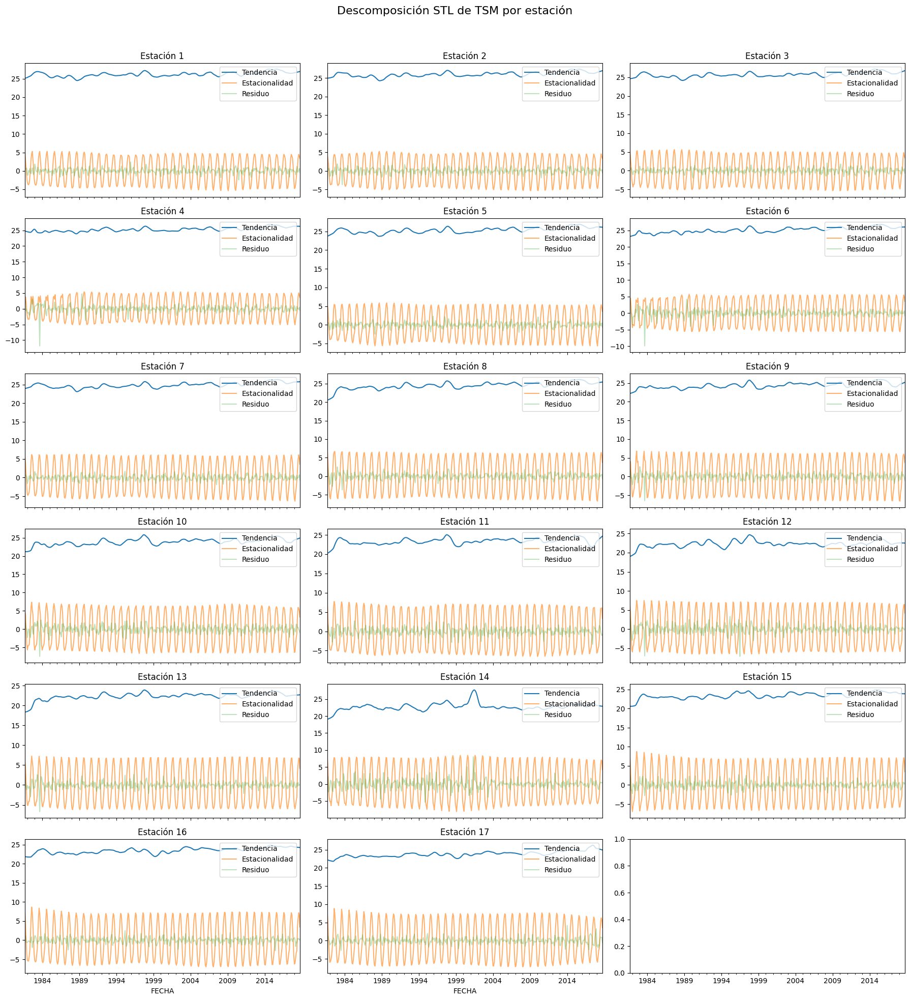

In [25]:
stl_results = {}

# Iterar sobre estaciones
for est in range(1, 18):
    est_df = tsm_long[tsm_long["Estacion"] == est].sort_values("FECHA").dropna(subset=["TSM"])
    if not est_df.empty:
        series = est_df.set_index("FECHA")["TSM"]
        stl = STL(series, period=12, seasonal=13)
        result = stl.fit()
        stl_results[est] = {
            "trend": result.trend,
            "seasonal": result.seasonal,
            "resid": result.resid,
            "observed": series
        }

# Graficar componentes STL para todas las estaciones
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(18, 20), sharex=True)
axes = axes.flatten()

for i, est in enumerate(stl_results.keys()):
    ax = axes[i]
    stl_results[est]["trend"].plot(ax=ax, label="Tendencia")
    stl_results[est]["seasonal"].plot(ax=ax, label="Estacionalidad", alpha=0.6)
    stl_results[est]["resid"].plot(ax=ax, label="Residuo", alpha=0.3)
    ax.set_title(f"Estación {est}")
    ax.legend(loc="upper right")

plt.suptitle("Descomposición STL de TSM por estación", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

 #### Boostrap

<ipython-input-26-a957bac6c608>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


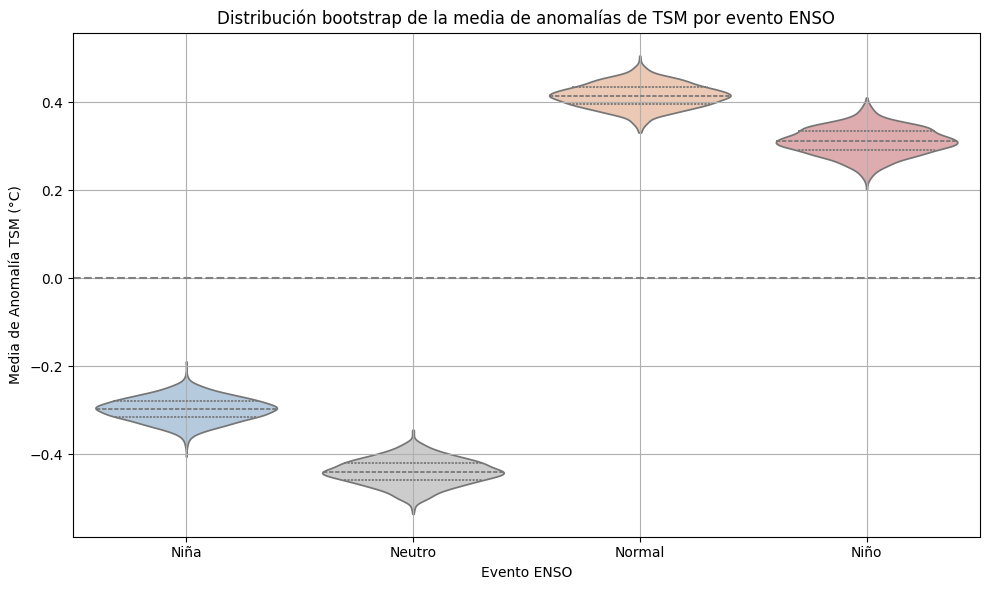

In [26]:
# Crear climatología mensual (promedio mensual por estación)
climatologia = tsm_long.groupby(["Estacion", tsm_long["FECHA"].dt.month])["TSM"].mean().reset_index()
climatologia.columns = ["Estacion", "Mes", "TSM_media"]

tsm_long["Mes"] = tsm_long["FECHA"].dt.month

# Calcular anomalías
tsm_anom = pd.merge(tsm_long, climatologia, on=["Estacion", "Mes"], how="left")
tsm_anom["Anomalia"] = tsm_anom["TSM"] - tsm_anom["TSM_media"]

# Aplicar bootstrap: estimar distribución de la media de anomalías por evento ENSO

# Agrupar por tipo de evento interanual (Niño, Neutro, Normal, Niña)
bootstrap_results = []
eventos = tsm_anom["EVENTO INTERANUAL"].dropna().unique()

for evento in eventos:
    datos = tsm_anom[tsm_anom["EVENTO INTERANUAL"] == evento]["Anomalia"].dropna()
    for i in range(1000):
        muestra = resample(datos, replace=True, n_samples=len(datos))
        media_boot = np.mean(muestra)
        bootstrap_results.append({"Evento": evento, "Media_anomalia": media_boot})

bootstrap_df = pd.DataFrame(bootstrap_results)

orden_eventos = ["Niña", "Neutro", "Normal", "Niño"]
colores = {
    "Niña": "#AFCBE3",    # azul pastel
    "Neutro": "#CCCCCC",  # gris claro
    "Normal": "#F4C7AB",  # naranja pastel
    "Niño": "#E6A4A7"     # rojo rosado pastel
}

plt.figure(figsize=(10, 6))
sns.violinplot(
    data=bootstrap_df,
    x="Evento", y="Media_anomalia",
    order=orden_eventos,
    palette=colores,
    cut=0, inner="quartile"
)
plt.axhline(0, color='gray', linestyle='--')
plt.title("Distribución bootstrap de la media de anomalías de TSM por evento ENSO")
plt.ylabel("Media de Anomalía TSM (°C)")
plt.xlabel("Evento ENSO")
plt.grid(True)
plt.tight_layout()
plt.show()

En términos generales, el **gráfico de violín** nos permite comparar cómo se distribuye la media de las anomalías de la TSM para diferentes tipos de eventos ENSO (El Niño, La Niña y Neutro/Normal). Cada "violín" representa la distribución de las medias calculadas a partir de múltiples remuestreos bootstrap de los datos originales para cada categoría de evento ENSO.

* *Eje X (Evento ENSO):* Muestra las diferentes categorías de eventos ENSO analizados.

* *Forma del Violín:* La anchura de cada forma de violín en una determinada altura del eje Y indica la densidad de puntos de datos (medias bootstrap) en ese valor de anomalía de TSM.

  * Un violín más ancho en un cierto rango de valores sugiere que hay una mayor probabilidad de obtener una media de anomalía de TSM dentro de ese rango para ese tipo de evento ENSO.
  * Un violín más estrecho indica una menor probabilidad.

* *Líneas Horizontales Dentro del Violín:* Estas líneas suelen representar medidas de tendencia central y dispersión de la distribución bootstrap:

  * La línea gruesa central indica la mediana de las medias bootstrap.
  * Las líneas punteadas superior e inferior representan los cuartiles (25% y 75%).

* Línea Horizontal Gris Discontinua en Y=0: Esta línea sirve como referencia para distinguir entre anomalías de TSM positivas (por encima de la línea, indicando temperaturas más cálidas de lo normal) y negativas (por debajo de la línea, indicando temperaturas más frías de lo normal).

**Procedimiento:**

  * El gráfico está mostrando la distribución de la media de las anomalías de la Temperatura Superficial del Mar (TSM).
  * Las anomalías se calcularon como la diferencia entre la TSM observada y su promedio mensual climatológico.
  * Se usó bootstrap para simular muchas veces (1000) estas medias y así construir una distribución de confianza por evento ENSO.


**Interpretación:**

| Elemento                | Significado                                                                |
| ----------------------- | -------------------------------------------------------------------------- |
| Cada “violín”           | Representa la **distribución simulada** de medias de anomalías por evento. |
| Ancho del violín        | **Densidad de probabilidad**: más ancho = más probable.                    |
| Línea horizontal negra  | Línea de referencia en **0°C** (sin anomalía).                             |
| Línea central (mediana) | Valor más representativo (centro de la distribución).                      |
| Extensión del violín    | Rango donde están los valores más extremos de la distribución.             |

Conclusiones clave:
* ENSO afecta la TSM de manera sistemática: Niño → +TSM, Niña → -TSM.
* Las distribuciones no se superponen alrededor de 0°C, lo que indica que las diferencias son estadísticamente significativas.
* El uso de bootstrap permite tener confianza en estas diferencias sin depender de supuestos normales.

#### Predicción

In [27]:
forecast_dict = {}

# Predecir para cada estación y guardar resultados
for est in range(1, 18):
    serie_est = tsm_long[tsm_long["Estacion"] == est].sort_values("FECHA")
    serie_est = serie_est.set_index("FECHA")["TSM"].asfreq("MS").interpolate()

    # Ajustar SARIMA
    try:
        modelo = SARIMAX(serie_est, order=(1,1,1), seasonal_order=(1,1,1,12),
                         enforce_stationarity=False, enforce_invertibility=False)
        resultado = modelo.fit(disp=False)
        pred = resultado.get_forecast(steps=12)
        pred_ci = pred.conf_int()
        forecast_dict[est] = {
            "observado": serie_est,
            "pred": pred.predicted_mean,
            "ci_inf": pred_ci.iloc[:, 0],
            "ci_sup": pred_ci.iloc[:, 1]
        }
    except:
        continue  # si alguna estación falla, se omite

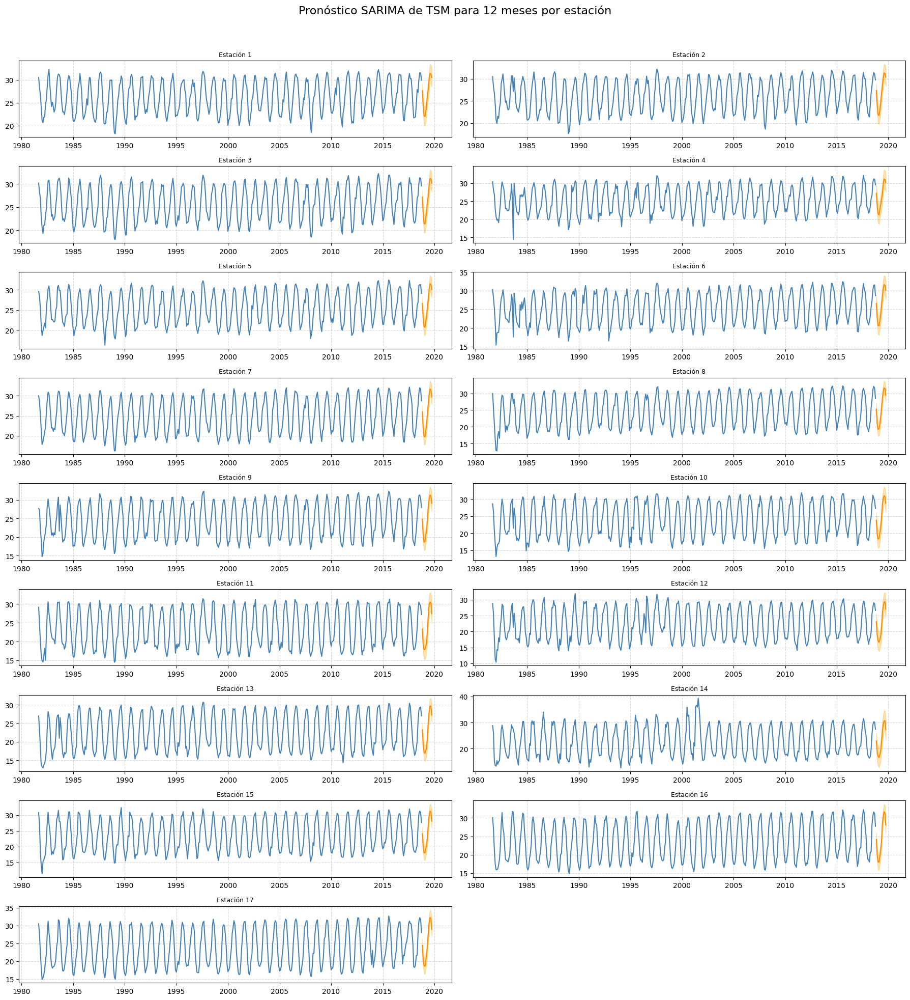

In [28]:
fig, axes = plt.subplots(nrows=9, ncols=2, figsize=(18, 20), sharex=False)
axes = axes.flatten()

for i, est in enumerate(sorted(forecast_dict.keys())):
    ax = axes[i]
    datos = forecast_dict[est]
    fechas_pred = datos["pred"].index.to_pydatetime()

    ci_inf = datos["ci_inf"].astype(float).values
    ci_sup = datos["ci_sup"].astype(float).values
    pred = datos["pred"].astype(float).values

    ax.plot(datos["observado"], label="Observado", color="steelblue")
    ax.plot(fechas_pred, pred, label="Predicción", color="darkorange")
    ax.fill_between(fechas_pred, ci_inf, ci_sup, color="orange", alpha=0.3)
    ax.set_title(f"Estación {est}", fontsize=9)
    ax.grid(True, linestyle='--', alpha=0.5)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])  # eliminar ejes sobrantes si no se usan

fig.suptitle("Pronóstico SARIMA de TSM para 12 meses por estación", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [29]:
# Crear mapa
m = folium.Map(location=[26, -111], zoom_start=6, tiles="CartoDB positron")
marker_cluster = MarkerCluster().add_to(m)

# Generar marcadores con gráficos
for _, row in coords_df.iterrows():
    est = row["Estacion"]
    if est not in forecast_dict:
        continue

    datos = forecast_dict[est]
    fechas_pred = datos["pred"].index.to_pydatetime()
    ci_inf = datos["ci_inf"].astype(float).values
    ci_sup = datos["ci_sup"].astype(float).values
    pred = datos["pred"].astype(float).values

    fig, ax = plt.subplots(figsize=(8, 4))
    ax.plot(datos["observado"], label="Observado", color="steelblue")
    ax.plot(fechas_pred, pred, label="Predicción", color="darkorange")
    ax.fill_between(fechas_pred, ci_inf, ci_sup, color="orange", alpha=0.3)
    ax.set_title(f"Pronóstico SARIMA de TSM para 12 meses - Estación {est}", fontsize=10)
    ax.tick_params(labelsize=8)
    ax.grid(True, linestyle="--", alpha=0.5)
    plt.tight_layout()

    img = BytesIO()
    plt.savefig(img, format="png")
    plt.close(fig)
    img.seek(0)
    encoded = base64.b64encode(img.read()).decode("utf-8")
    html = f'<img src="data:image/png;base64,{encoded}">'
    iframe = folium.IFrame(html, width=850, height=420)

    folium.Marker(
        location=[row["Latitud"], row["Longitud"]],
        popup=folium.Popup(iframe),
        tooltip=f"Estación {est}"
    ).add_to(marker_cluster)

m

In [30]:
tsm_long

,FECHA,AÑO,MES,ESTACIÓN DEL AÑO,EVENTO INTERANUAL,Estacion,TSM,Mes
0,1981-09-01,1981,Septiembre,Otoño,Neutro,1,30.5000,9
1,1981-10-01,1981,Octubre,Otoño,Neutro,1,28.3833,10
2,1981-11-01,1981,Noviembre,Otoño,Neutro,1,26.7750,11
3,1981-12-01,1981,Diciembre,Invierno,Neutro,1,24.0667,12
4,1982-01-01,1982,Enero,Invierno,Neutro,1,21.0583,1
...,...,...,...,...,...,...,...,...
7577,2018-06-01,2018,Junio,Verano,Normal,17,27.7339,6
7578,2018-07-01,2018,Julio,Verano,Normal,17,31.0978,7
7579,2018-08-01,2018,Agosto,Verano,Normal,17,32.1800,8
7580,2018-09-01,2018,Septiembre,Otoño,Niño,17,31.6606,9


In [48]:
# 1. Preparar datos históricos con etiquetas ENSO ya presentes
tsm_filtered = tsm_long[(tsm_long["FECHA"] >= "2002-01-01")].copy()
tsm_filtered = tsm_filtered[["FECHA", "Estacion", "TSM", "EVENTO INTERANUAL"]].copy()
tsm_filtered.rename(columns={"EVENTO INTERANUAL": "ENSO_clasif"}, inplace=True)

# 2. Agregar predicciones SARIMA a cada estación
future_data = []
for est, datos in forecast_dict.items():
    fechas_pred = datos["pred"].index
    for fecha, valor in zip(fechas_pred, datos["pred"]):
        future_data.append({
            "FECHA": fecha,
            "Estacion": est,
            "TSM": valor
        })
future_df = pd.DataFrame(future_data)
future_df["FECHA"] = pd.to_datetime(future_df["FECHA"])

# 3. Calcular anomalías proyectadas a partir de climatología mensual
# Calcular climatología mensual de datos históricos
climatologia = tsm_filtered.copy()
climatologia["Mes"] = climatologia["FECHA"].dt.month
clim_mensual = climatologia.groupby(["Estacion", "Mes"])["TSM"].mean().reset_index()
clim_mensual.columns = ["Estacion", "Mes", "TSM_media"]

# Unir predicciones con su mes y climatología
future_df["Mes"] = future_df["FECHA"].dt.month
future_anom = pd.merge(future_df, clim_mensual, on=["Estacion", "Mes"], how="left")
future_anom["Anomalia"] = future_anom["TSM"] - future_anom["TSM_media"]

# Promediar anomalía mensual entre estaciones
media_anom_fut = future_anom.groupby("FECHA")["Anomalia"].mean().reset_index()
media_anom_fut["ENSO_clasif"] = media_anom_fut["Anomalia"].apply(
    lambda x: "Niño" if x >= 0.5 else ("Niña" if x <= -0.5 else "Neutro")
)

# Unir clasificación ENSO proyectada a datos futuros
future_tagged = pd.merge(future_df, media_anom_fut[["FECHA", "ENSO_clasif"]], on="FECHA", how="left")

# 4. Unir históricos y futuros
tsm_combined = pd.concat([tsm_filtered, future_tagged], ignore_index=True)

# 5. Agregar coordenadas
tsm_geo = pd.merge(tsm_combined, coords_df, on="Estacion", how="left")

# 6. Redondear fechas al primer día del mes
tsm_geo["FECHA"] = pd.to_datetime(tsm_geo["FECHA"]).dt.to_period("M").dt.to_timestamp()

# 7. Normalizar TSM
tsm_min = tsm_geo["TSM"].min()
tsm_max = tsm_geo["TSM"].max()
tsm_geo["TSM_norm"] = (tsm_geo["TSM"] - tsm_min) / (tsm_max - tsm_min)

# 8. Función de color
def color_scale(tsm):
    rgba = cm.inferno(tsm)
    return f"rgba({int(rgba[0]*255)}, {int(rgba[1]*255)}, {int(rgba[2]*255)}, 0.8)"

# 9. Crear GeoJSON para mapa animado
features = []
for _, row in tsm_geo.iterrows():
    popup_text = f"""
    <b>Estación {row['Estacion']}</b><br>
    Fecha: {row['FECHA'].strftime('%Y-%m')}<br>
    TSM: {row['TSM']:.2f} °C<br>
    ENSO: {row['ENSO_clasif']}
    """
    feature = {
        "type": "Feature",
        "geometry": {
            "type": "Point",
            "coordinates": [row["Longitud"], row["Latitud"]]
        },
        "properties": {
            "time": row["FECHA"].strftime("%Y-%m-%dT%H:%M:%S"),
            "style": {
                "color": color_scale(row["TSM_norm"]),
                "fillColor": color_scale(row["TSM_norm"]),
                "fillOpacity": 0.7,
                "radius": 6
            },
            "icon": "circle",
            "popup": popup_text
        }
    }
    features.append(feature)

geojson = {
    "type": "FeatureCollection",
    "features": features
}

# 10. Crear el mapa con animación temporal

m = folium.Map(location=[26, -111], zoom_start=6, tiles="CartoDB positron")
TimestampedGeoJson(
    data=geojson,
    transition_time=300,
    period="P1M",
    add_last_point=True,
    loop=False,
    auto_play=True,
    max_speed=1,
    loop_button=True,
    date_options='YYYY-MM',
    time_slider_drag_update=True
).add_to(m)

m


### Chla a

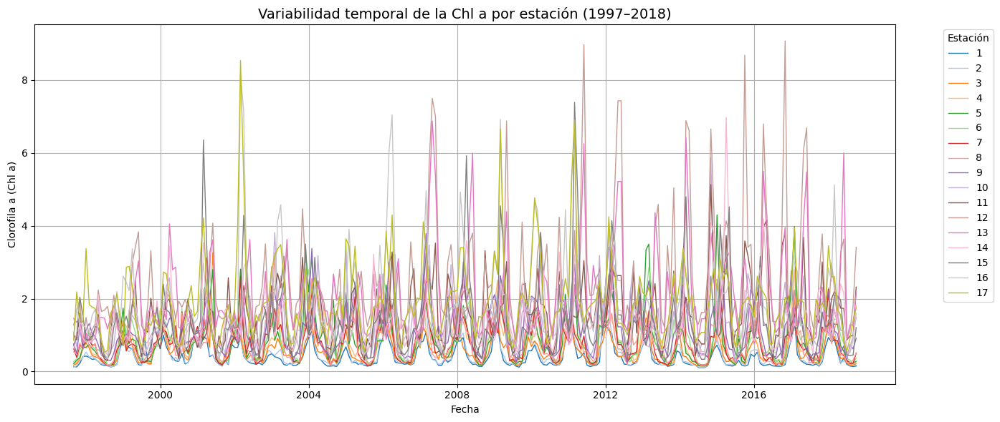

In [32]:
# Calcular el promedio mensual de TSM por estación
chla_avg_by_station = chla_geo.groupby(["FECHA", "Estacion"])["Chla"].mean().reset_index()

plt.figure(figsize=(14, 6))
sns.lineplot(data=chla_avg_by_station, x="FECHA", y="Chla", hue="Estacion", palette="tab20", linewidth=1)
plt.title("Variabilidad temporal de la Chl a por estación (1997–2018)", fontsize=14)
plt.xlabel("Fecha")
plt.ylabel("Clorofila a (Chl a)")
plt.legend(title="Estación", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(True)
plt.show()

#### Análisis de frecuencia - Transformada de Fourier (FFT)

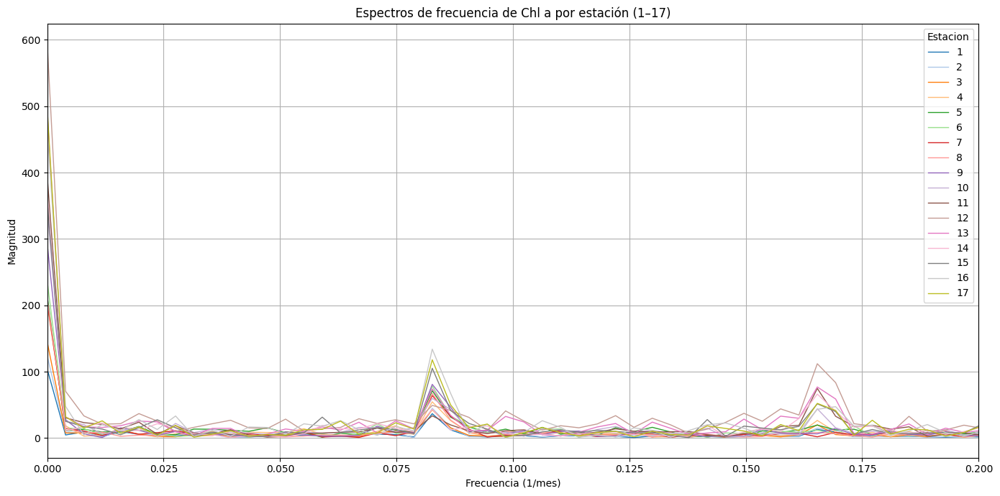

In [33]:
# Análisis de frecuencia para cada estación
fft_results = []

for est in range(1, 18):
    sub_df = chla_geo[chla_geo["Estacion"] == est].sort_values("FECHA")
    sub_series = sub_df["Chla"].dropna().values
    n = len(sub_series)
    if n > 0:
        freqs = fftfreq(n, d=1)
        fft_vals = fft(sub_series)
        pos_freqs = freqs[:n // 2]
        pos_fft = np.abs(fft_vals[:n // 2])
        fft_results.append(pd.DataFrame({
            "Frecuencia": pos_freqs,
            "Magnitud": pos_fft,
            "Estacion": est
        }))

fft_df_all = pd.concat(fft_results, ignore_index=True)

plt.figure(figsize=(14, 7))
sns.lineplot(data=fft_df_all, x="Frecuencia", y="Magnitud", hue="Estacion", palette="tab20", lw=1)
plt.title("Espectros de frecuencia de Chl a por estación (1–17)")
plt.xlabel("Frecuencia (1/mes)")
plt.ylabel("Magnitud")
plt.xlim(0, 0.2)
plt.grid(True)
plt.tight_layout()
plt.show()

**Ejes:**
* *Eje X (Frecuencia):* Indica la frecuencia en unidades de 1/mes (ciclos por mes). Un valor de 0.1 representa un ciclo que se repite cada 1/0.1 = 10 meses. Valores cercanos a 0 indican variaciones de muy largo plazo, mientras que valores más altos representan variaciones más rápidas o de ciclo más corto.
* *Eje Y (Magnitud):* Representa la amplitud o la fuerza de cada componente de frecuencia en la señal de la Clorofila a (Chl *a*) para cada estación. Un pico alto en una frecuencia específica para una estación indica que esa frecuencia contribuye de manera significativa a la variabilidad temporal de la Chl *a* en esa estación.

**Interpretación del gráfico:**

Se pueden identificar varios patrones importantes:

* *Pico Dominante en Frecuencias Muy Bajas (Cercanas a 0):* Para todas las estaciones, se observa un pico muy alto en las frecuencias cercanas a 0.

  * **Interpretación:** Esto indica que la variabilidad de la Chl *a* en todas las estaciones está dominada por cambios de muy largo plazo. Esto podría representar tendencias a largo plazo (calentamiento o enfriamiento sostenido durante el periodo analizado) o ciclos de muy baja frecuencia que abarcan varios años. La magnitud tan alta sugiere que esta es la componente más importante de la variabilidad de la Chl *a* en la región estudiada.

* *Pico Significativo alrededor de 0.083 (1/mes):* Para muchas estaciones, se observa un pico notable alrededor de la frecuencia de 0.083 ciclos por mes.

  * **Cálculo del Periodo:** Un periodo correspondiente a una frecuencia de 0.083 ciclos/mes es aproximadamente 1/0.083 ≈ 12.05 meses.

  * **Interpretación:** Este pico sugiere una fuerte variabilidad anual (ciclo de aproximadamente 12 meses) en la Chl *a* para estas estaciones. Esto es muy probablemente la señal de la estacionalidad, con las variaciones entre las temperaturas más cálidas y más frías a lo largo del año; esto tiene sentido biológicamente debido a los ciclos estacionales de luz, nutrientes y estratificación de la columna de agua que influyen en la proliferación del fitoplancton (que contiene clorofila a). La altura de este pico varía entre las estaciones, lo que indica que la intensidad de la señal anual es diferente en cada ubicación.

* *Otros Picos Menores:* Se pueden observar picos de menor magnitud en otras frecuencias para algunas estaciones.

  * **Interpretación:** Estos picos indican la presencia de variabilidad con otros periodos, pero su contribución a la variabilidad total de la Chl *a* es menor en comparación con la variabilidad de largo plazo y la anual. Podrían estar relacionados con otros ciclos climáticos, fenómenos regionales o incluso, ciclos lunares (que influyen en las mareas y la mezcla vertical). Sin embargo, alrededor de la frecuencia de 0.165 ciclos por mes ≈ 6 meses, los picos son bastante similares a los picos  de frecuencia correspondiente a los 12 meses.

* *Variabilidad entre Estaciones:* Los espectros de frecuencia no son idénticos para todas las estaciones.

  * **Interpretación:** Esto sugiere que la naturaleza y la intensidad de la variabilidad temporal de la Chl *a* difieren entre las distintas ubicaciones representadas por las estaciones. Algunas estaciones pueden tener una señal anual más pronunciada, mientras que otras pueden mostrar una mayor influencia de otras frecuencias.

**Resumen:**

Este gráfico revela que la variabilidad temporal de la Chl *a* en la región estudiada (representada por las 17 estaciones) está caracterizada principalmente por:

  * Una fuerte componente de variabilidad de muy largo plazo, dominante en todas las estaciones.
  * Una significativa componente de variabilidad anual (estacionalidad) en muchas estaciones, con diferente intensidad según la ubicación.
  * Una componente de variabilidad intranual (6 meses) similar a la variabilidad anual en muchas estaciones, con diferente intensidad según la ubicación.
  * Variaciones con otros periodos más cortos, pero con menor influencia general.
  * Diferencias notables en los espectros de frecuencia entre las distintas estaciones, lo que indica una variabilidad espacial en el comportamiento temporal de la Chl *a*.

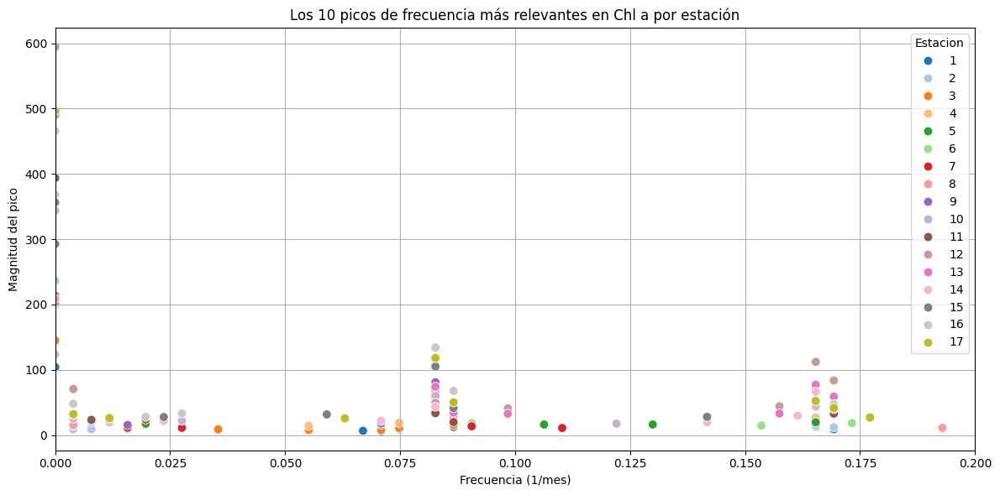

In [34]:
# Analizar los picos de frecuencia
peaks_data = []
n_top_peaks = 10

for est in range(1, 18):
    sub_df = chla_geo[chla_geo["Estacion"] == est].sort_values("FECHA")
    sub_series = sub_df["Chla"].dropna().values
    n = len(sub_series)
    if n > 0:
        freqs = fftfreq(n, d=1)
        fft_vals = fft(sub_series)
        pos_freqs = freqs[:n // 2]
        pos_fft = np.abs(fft_vals[:n // 2])

        all_freqs = np.concatenate(([0], pos_freqs))
        all_fft = np.concatenate(([np.abs(fft_vals[0])], pos_fft))

        # Encontrar los indices de los N picos más altos
        top_peak_indices = np.argsort(all_fft)[::-1][:n_top_peaks]

        for idx in top_peak_indices:
            peaks_data.append({
                "Estacion": est,
                "Frecuencia": all_freqs[idx],
                "Magnitud": all_fft[idx]
            })

peaks_df = pd.DataFrame(peaks_data)

plt.figure(figsize=(12, 6))
sns.scatterplot(data=peaks_df, x="Frecuencia", y="Magnitud", hue="Estacion", palette="tab20", s=60)
plt.title(f"Los {n_top_peaks} picos de frecuencia más relevantes en Chl a por estación")
plt.xlabel("Frecuencia (1/mes)")
plt.ylabel("Magnitud del pico")
plt.xlim(0, 0.2)
plt.grid(True)
plt.tight_layout()
plt.show()

**Ejes:**

* *Eje X (Frecuencia):* Al igual que en el gráfico anterior, indica la frecuencia en unidades de 1/mes (ciclos por mes).
* *Eje Y (Magnitud del pico):* Representa la amplitud o la fuerza del pico de frecuencia en el espectro de la Chl *a* para cada estación. Un punto con una magnitud alta en una frecuencia específica indica que esa frecuencia tiene una contribución importante a la variabilidad de la Chl *a* en esa estación.

**Interpretación del gráfico:**

Este gráfico se enfoca en los picos más importantes del espectro de frecuencia para cada estación, en lugar de mostrar el espectro completo. Cada punto representa una frecuencia donde la variabilidad de la Chl *a* es particularmente fuerte para una estación específica. En específico se observan los 10 picos de frecuencia más relevantes por estación.

* *Picos Dominantes en Frecuencias Bajas (Cercanas a 0):* Para la mayoría de las estaciones, se observan picos con magnitudes relativamente altas en frecuencias muy cercanas a 0.

  * **Interpretación:** Esto refuerza la idea del gráfico anterior de que la variabilidad de largo plazo es una componente importante de la Chl *a* en muchas estaciones. La altura de estos puntos indica la fuerza de esta variabilidad de baja frecuencia para cada estación. Podemos ver que algunas estaciones (identificables por su color) tienen picos de baja frecuencia mucho más altos que otras, lo que sugiere una mayor influencia de tendencias o ciclos de muy largo plazo en esas ubicaciones.

* *Picos alrededor de 0.083 (Variabilidad Anual):* Muchos puntos se agrupan alrededor de la frecuencia de 0.083 ciclos por mes (aproximadamente 12 meses o 1 año).

  * **Interpretación:** Esto confirma la presencia de una fuerte señal anual (estacionalidad) en la Chl *a* para la mayoría de las estaciones. La magnitud de estos picos varía entre las estaciones, lo que indica diferencias en la intensidad de la variación anual de la Chl *a* según la ubicación. Algunas estaciones muestran picos anuales mucho más pronunciados que otras.

* *Picos en Otras Frecuencias:* Se observan puntos en otras frecuencias a lo largo del eje X, aunque generalmente con magnitudes más bajas que los picos de baja frecuencia y los picos anuales.

  * **Interpretación:** Estos picos representan variabilidad de la Chl *a* con otros periodos. Por ejemplo:
    * Alrededor de 0.166 (1/mes): Correspondería a un ciclo de aproximadamente 6 meses (semi-anual). La magnitud de estos picos varía entre las estaciones y tienen una magnitud similar a los ciclos anuales.
    * Frecuencias aún más altas representarían ciclos más cortos.
  * La presencia de estos picos varía entre las estaciones, sugiriendo que algunas ubicaciones experimentan variabilidad significativa en estas escalas de tiempo, mientras que otras no.

* *Variabilidad entre Estaciones (Picos Específicos):* Al observar los diferentes colores (estaciones), podemos ver que algunas estaciones tienen picos muy prominentes en ciertas frecuencias donde otras no los tienen, o los tienen con magnitudes mucho menores.

  * **Interpretación:** Esto subraya la heterogeneidad espacial en la variabilidad temporal de la Chl *a*. Los procesos que influyen en la Chl *a* pueden operar a diferentes escalas de tiempo y con diferente intensidad en distintas ubicaciones geográficas.

**Resumen:**

Este gráfico de picos de frecuencia proporciona una visión concisa de las escalas de tiempo más importantes de la variabilidad de la Chl *a* para cada estación:

  * La **variabilidad de largo plazo (frecuencias bajas)** es una característica dominante en muchas estaciones.
  * La **variabilidad anual (alrededor de 0.083 1/mes)** es también muy importante y presente en la mayoría de las estaciones, aunque con diferente intensidad.
  * Otras escalas de tiempo de variabilidad (frecuencias más altas) existen, pero generalmente con menor magnitud y variando en su presencia e intensidad entre las estaciones.

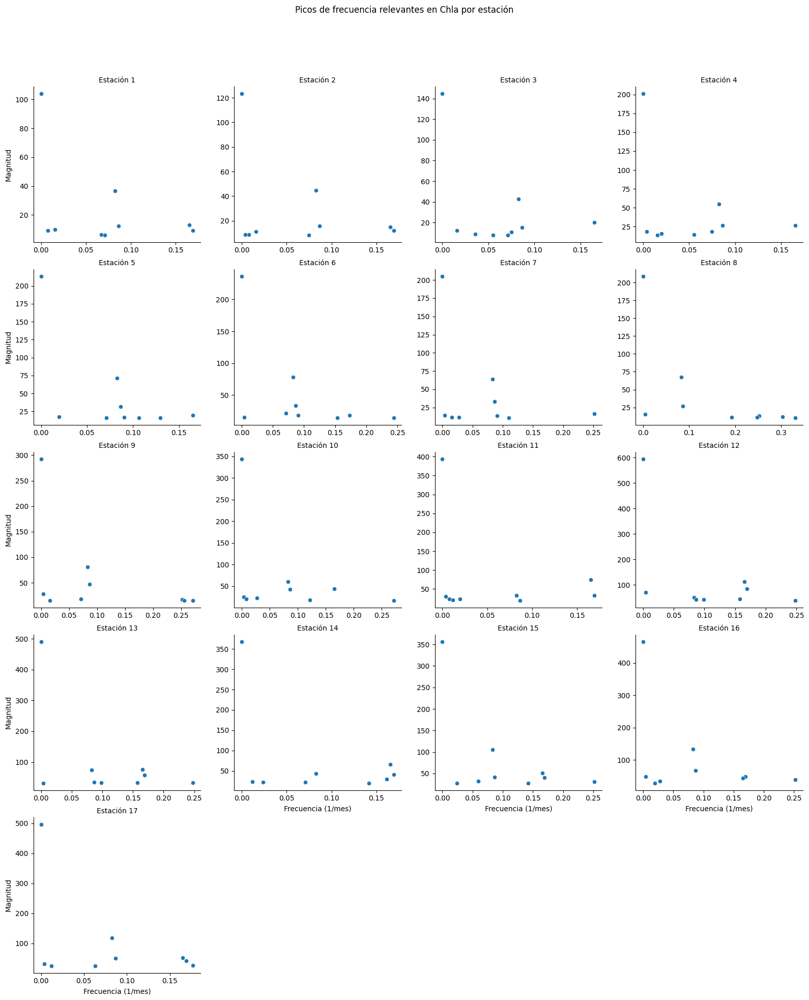

In [35]:
# Detectar picos de frecuencia más significativos por estación
peaks_data = []
n_top_peaks = 10

for est in range(1, 18):
    sub_df = chla_geo[chla_geo["Estacion"] == est].sort_values("FECHA")
    sub_series = sub_df["Chla"].dropna().values
    n = len(sub_series)
    if n > 0:
        freqs = fftfreq(n, d=1)
        fft_vals = fft(sub_series)
        pos_freqs = freqs[:n // 2]
        pos_fft = np.abs(fft_vals[:n // 2])

        all_freqs = np.concatenate(([0], pos_freqs))
        all_fft = np.concatenate(([np.abs(fft_vals[0])], pos_fft))

        # Encontrar los indices de los N picos más altos
        top_peak_indices = np.argsort(all_fft)[::-1][:n_top_peaks]

        for idx in top_peak_indices:
            peaks_data.append({
                "Estacion": est,
                "Frecuencia": all_freqs[idx],
                "Magnitud": all_fft[idx]
            })

peaks_df = pd.DataFrame(peaks_data)

g = sns.FacetGrid(peaks_df, col="Estacion", col_wrap=4, height=4, sharex=False, sharey=False)
g.map_dataframe(sns.scatterplot, x="Frecuencia", y="Magnitud")
g.set_titles("Estación {col_name}")
g.set_axis_labels("Frecuencia (1/mes)", "Magnitud")
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Picos de frecuencia relevantes en Chla por estación")
plt.show()

#### Análisis espectral (Análisis Wavelet)

<ipython-input-49-7ed5dd0210be>:34: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.94])


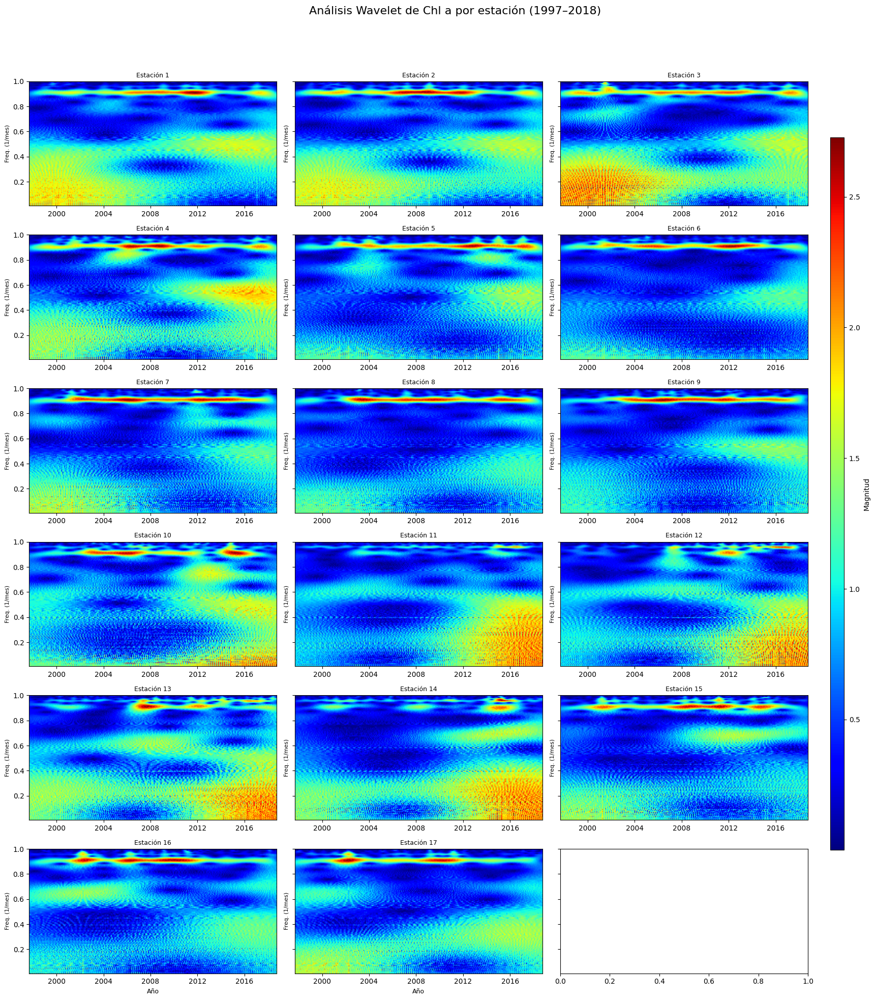

In [49]:
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(18, 20), sharey=True)
axes = axes.flatten()

# Escalas y configuración para wavelet
wavelet = 'cmor1.5-1.0'
scales = np.arange(1, 128)

# Generar wavelet para cada estación
for i, est in enumerate(range(1, 18)):
    sub_df = chla_long[chla_long["Estacion"] == est].sort_values("FECHA")
    sub_df = sub_df.dropna(subset=["Chla"])
    if not sub_df.empty:
        series = sub_df.set_index("FECHA")["Chla"]
        coef, freqs = pywt.cwt(series.values, scales, wavelet, sampling_period=1)

        # Convertir fechas a ordinales para eje X
        times = mdates.date2num(series.index.to_pydatetime())
        extent = [times[0], times[-1], freqs[-1], freqs[0]]

        ax = axes[i]
        im = ax.imshow(np.abs(coef), extent=extent, cmap='jet', aspect='auto')
        ax.set_title(f'Estación {est}', fontsize=9)
        ax.set_ylabel('Freq. (1/mes)', fontsize=8)
        ax.xaxis_date()
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        if i >= 15:
            ax.set_xlabel('Año', fontsize=9)

fig.subplots_adjust(right=0.88, top=0.95)
cbar_ax = fig.add_axes([0.91, 0.15, 0.015, 0.7])
fig.colorbar(im, cax=cbar_ax, label="Magnitud")

fig.suptitle("Análisis Wavelet de Chl a por estación (1997–2018)", fontsize=16)
plt.tight_layout(rect=[0, 0, 0.9, 0.94])
plt.show()

**Componentes del Gráfico:**

* *Eje X (Tiempo):* El eje horizontal en cada panel representa el tiempo, que en este caso abarca desde aproximadamente 1981 hasta 2018.
* *Eje Y (Periodo o Escala):* El eje vertical representa el periodo de las oscilaciones detectadas. Generalmente, la escala se muestra de forma logarítmica o pseudo-logarítmica, donde los valores más bajos están en la parte superior (periodos más cortos, como meses) y los valores más altos en la parte inferior (periodos más largos, como años). A veces, en lugar de periodo, se muestra la escala wavelet, que está directamente relacionada con el periodo.
* *Escala de Color (Magnitud o Potencia):* La barra de color a la derecha del gráfico general indica la magnitud o potencia de las oscilaciones en cada escala de tiempo para cada punto en el tiempo.
  * Colores cálidos (rojo, amarillo): Representan alta potencia o fuerte presencia de oscilaciones en esa escala de tiempo en ese momento específico.
  * Colores fríos (azul, verde): Representan baja potencia o débil presencia de oscilaciones.


**Interpretación del Gráfico:**

**Patrones Similares Observados en la Mayoría de las Estaciones:**

  * *Dominancia de la Variabilidad Anual:* La característica más sobresaliente en la mayoría, si no en todas las estaciones, es una banda persistente de alta potencia centrada alrededor de la frecuencia correspondiente a un periodo de un año (aproximadamente 1/12 ciclos por mes). Esto confirma una fuerte influencia estacional en la proliferación del fitoplancton y, por ende, en la concentración de clorofila a en todo el Golfo. La consistencia de esta señal anual a lo largo del tiempo sugiere que los ciclos estacionales de luz, temperatura y nutrientes son un factor de control primario en la productividad primaria de la región.

  * *Variabilidad Interanual Significativa (Escalas de 2-5 años o más)*: Muchas estaciones exhiben áreas de potencia elevada en escalas de tiempo interanuales, particularmente en el rango de 2 a 5 años. La aparición no uniforme de estos eventos de alta potencia a lo largo del tiempo sugiere una modulación de la productividad primaria por fenómenos de escala interanual, posiblemente relacionados con la variabilidad climática como El Niño-Oscilación del Sur (ENOS). Sin embargo, la intensidad y el momento exacto de estos picos interanuales varían entre estaciones, indicando una respuesta espacialmente heterogénea a estos eventos de gran escala.

**Patrones Diferentes y Agrupaciones Tentativas de Estaciones:**

Si bien la señal anual es un rasgo fundamental, se pueden observar algunas diferencias y posibles agrupaciones de estaciones basadas en la modulación de esta señal y la prominencia de la variabilidad interanual:

  * *Variabilidad Interanual Temprana vs. Tardía:* Algunas estaciones (ej., Estación 3) parecen mostrar una variabilidad interanual más marcada en la primera parte del periodo de estudio (1997-2006), mientras que otras (ej., Estaciones 10-14) presentan una mayor intensidad de esta variabilidad en la última parte (2012-2018). Esto podría sugerir una respuesta diferencial a los forzamientos climáticos interanuales a lo largo del tiempo y entre diferentes regiones del Golfo.

  * *Intensidad Variable de la Señal Anual:* La intensidad de la banda de alta potencia anual no es uniforme entre las estaciones. Algunas estaciones muestran una señal anual consistentemente más fuerte que otras, lo que podría reflejar diferencias en la amplitud de la floración estacional del fitoplancton debido a factores locales como la profundidad, la cercanía a la costa, la influencia de corrientes o el aporte de nutrientes.

  * *Variabilidad Subanual Esporádica:* Se observa que ciertas estaciones se caracterizan por incrementos en la potencia de las señales subanuales, con un énfasis particular en las fluctuaciones que ocurren en una escala de tiempo de aproximadamente 2 meses. Estos podrían estar relacionados con eventos oceanográficos de menor escala o con pulsos de nutrientes asociados a fenómenos locales.

  * *Estaciones con Patrones Atípicos:* Existen estaciones individuales con patrones únicos en ciertas escalas de tiempo que no se ajustan a las tendencias generales. Estas anomalías podrían ser indicativas de dinámicas ecológicas o oceanográficas particulares en esas ubicaciones específicas.


Duda: Q le pasa a la clorofila cada 2 meses  ?


#### Descomposición STL (Seasonal-Trend decomposition using Loess)

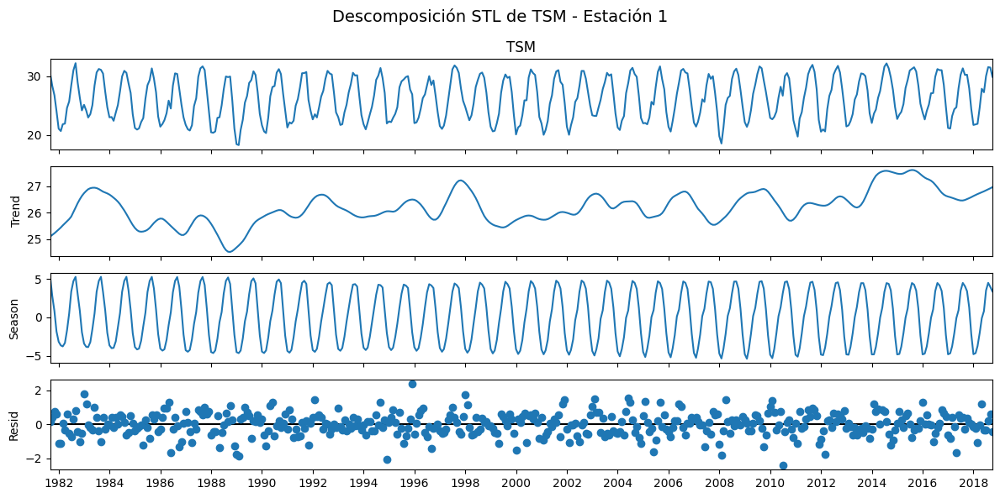

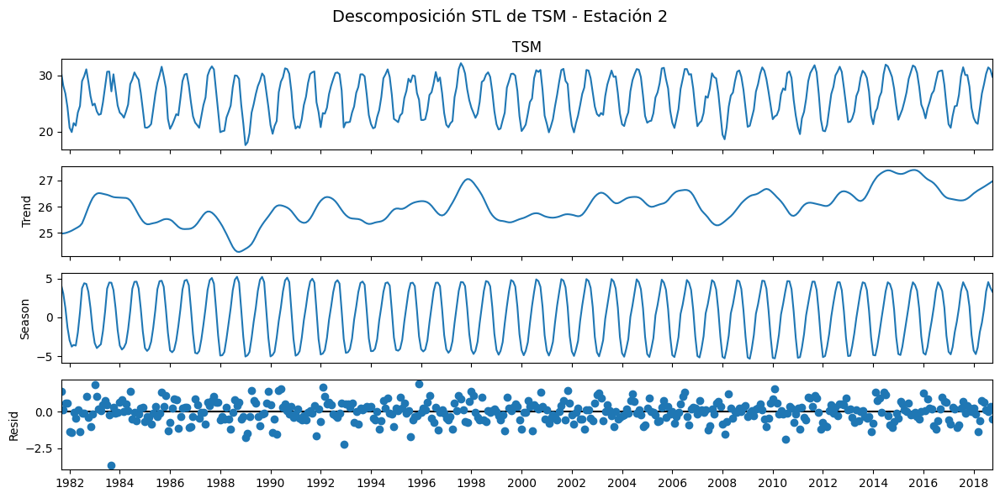

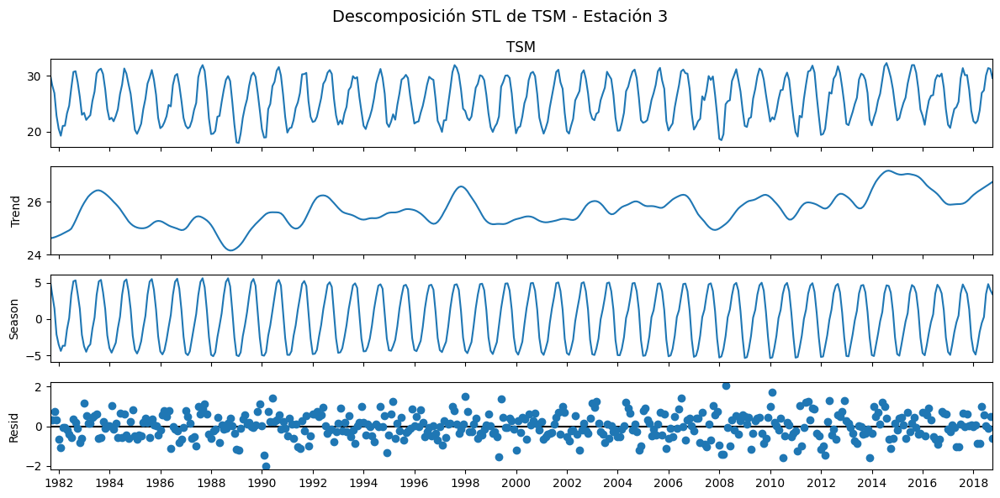

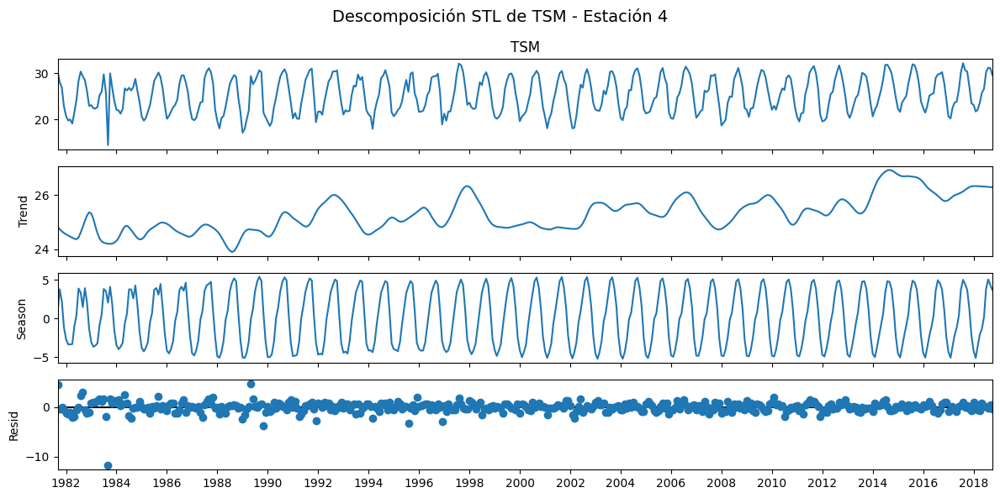

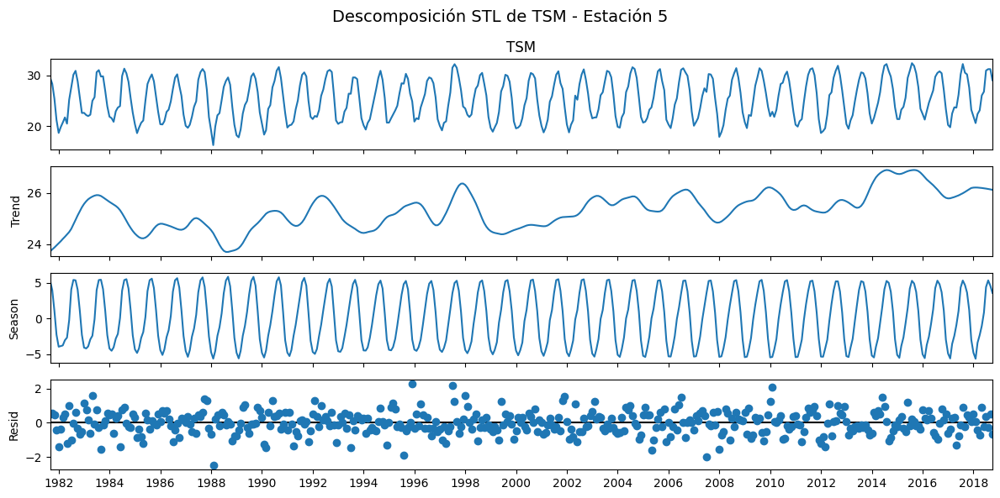

...

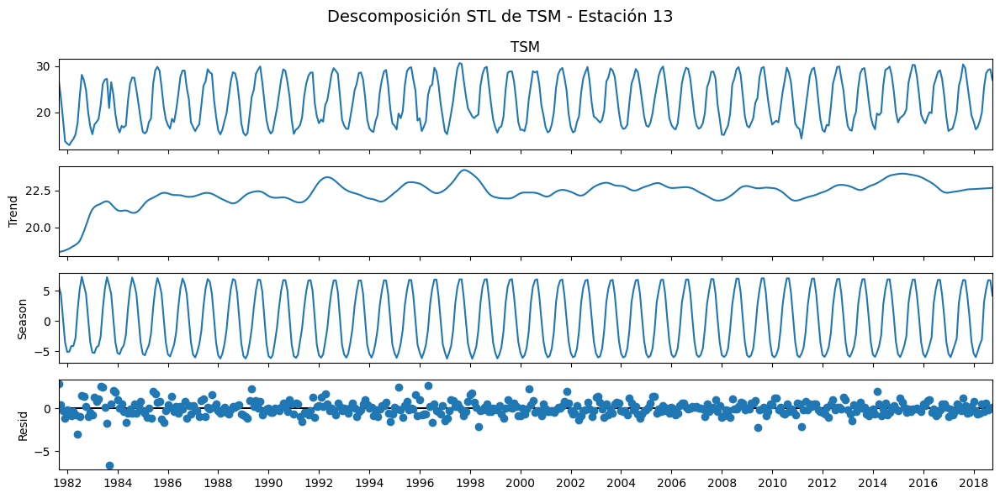

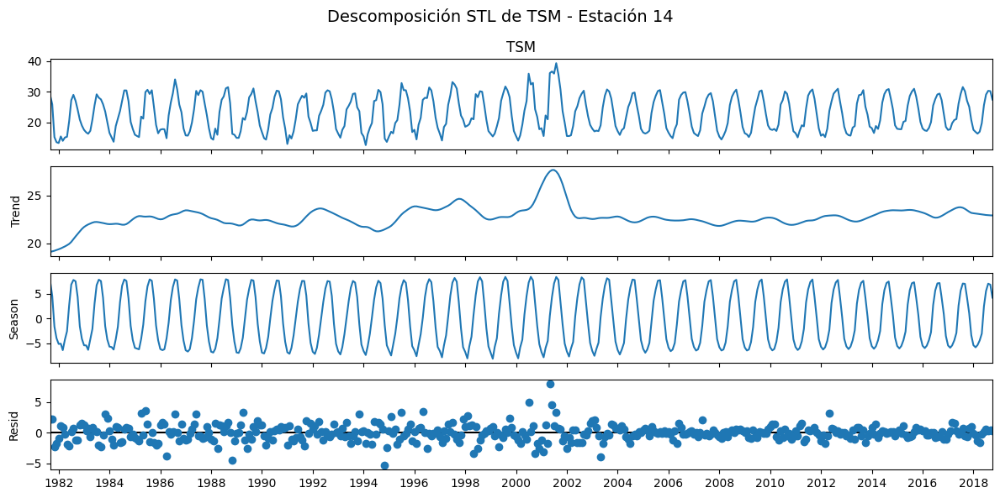

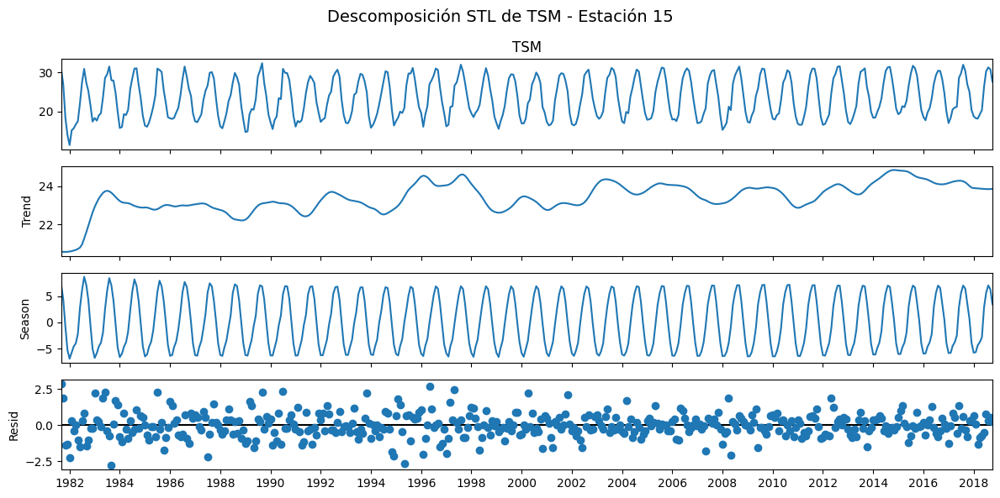

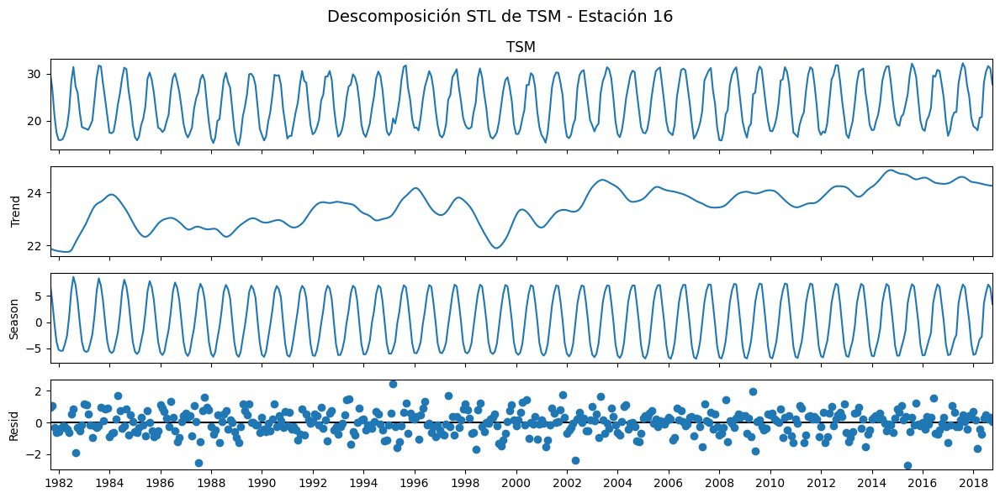

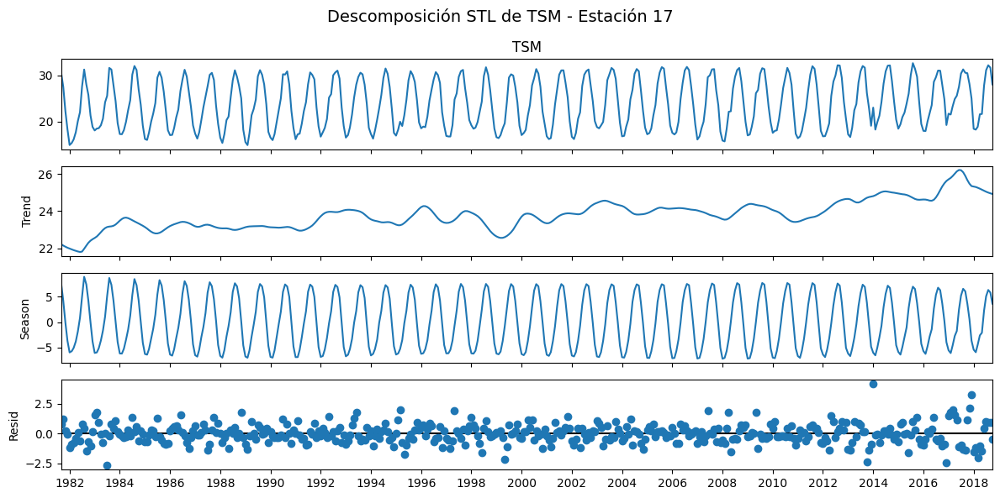

In [37]:
for i in range(1, 18):
  tsm_est = tsm_long[tsm_long["Estacion"] == i].sort_values("FECHA")
  tsm_est = tsm_est.dropna(subset=["TSM"])

  tsm_series = tsm_est.set_index("FECHA")["TSM"]

  # Aplicar STL
  stl = STL(tsm_series, period=12, seasonal=13)
  result = stl.fit()

  fig = result.plot()
  fig.set_size_inches(12, 6)

  ax = fig.gca()
  x_ticks = ax.get_xticks()

  x_ticks_dates = [mdates.num2date(tick) for tick in x_ticks]

  ax.xaxis.set_major_locator(mdates.YearLocator(2))
  ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

  plt.suptitle(f"Descomposición STL de TSM - Estación {i}", fontsize=14)
  plt.tight_layout()
  plt.show()

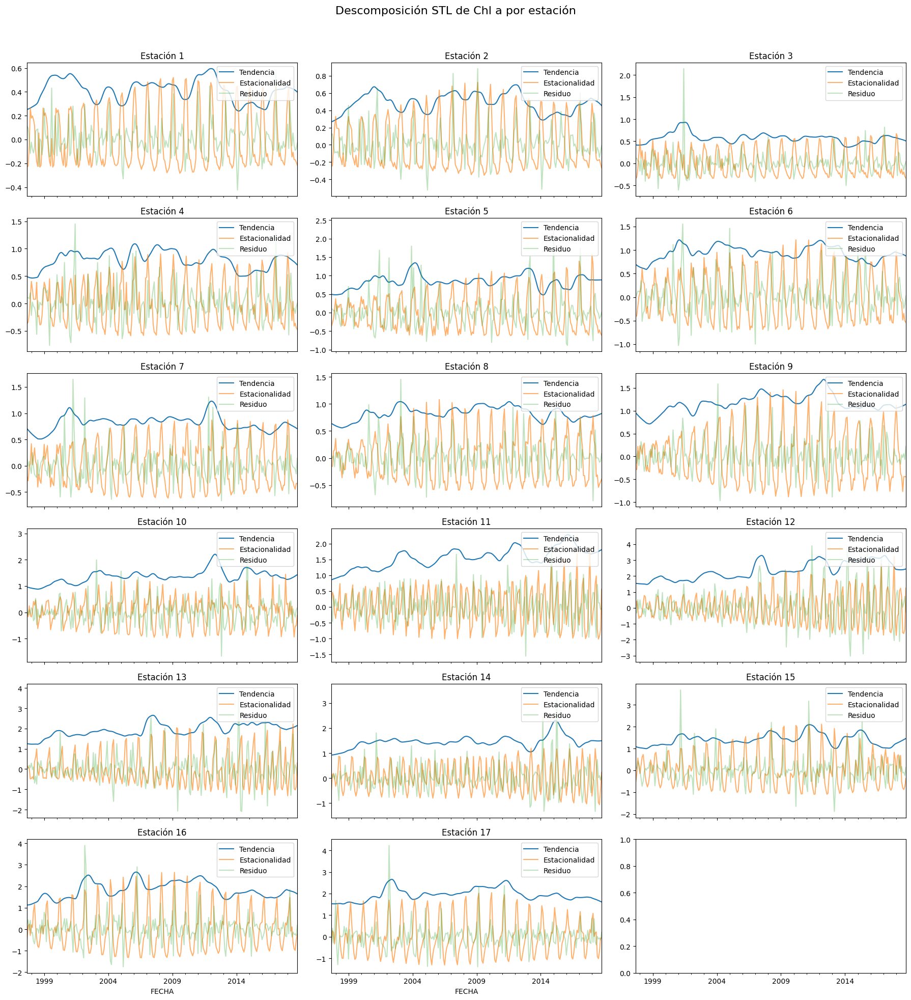

In [51]:
stl_results = {}

# Iterar sobre estaciones
for est in range(1, 18):
    est_df = chla_long[chla_long["Estacion"] == est].sort_values("FECHA").dropna(subset=["Chla"])
    if not est_df.empty:
        series = est_df.set_index("FECHA")["Chla"]
        stl = STL(series, period=12, seasonal=13)
        result = stl.fit()
        stl_results[est] = {
            "trend": result.trend,
            "seasonal": result.seasonal,
            "resid": result.resid,
            "observed": series
        }

# Graficar componentes STL para todas las estaciones
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(18, 20), sharex=True)
axes = axes.flatten()

for i, est in enumerate(stl_results.keys()):
    ax = axes[i]
    stl_results[est]["trend"].plot(ax=ax, label="Tendencia")
    stl_results[est]["seasonal"].plot(ax=ax, label="Estacionalidad", alpha=0.6)
    stl_results[est]["resid"].plot(ax=ax, label="Residuo", alpha=0.3)
    ax.set_title(f"Estación {est}")
    ax.legend(loc="upper right")

plt.suptitle("Descomposición STL de Chl a por estación", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

 #### Boostrap

<ipython-input-53-06ccb3e22710>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


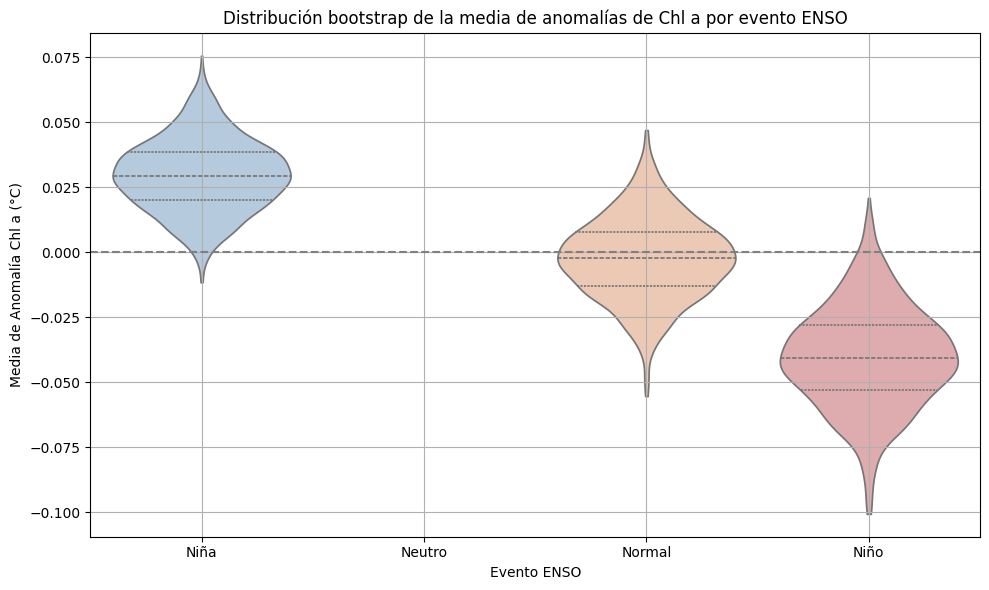

In [53]:
# Crear climatología mensual (promedio mensual por estación)
climatologia = chla_long.groupby(["Estacion", chla_long["FECHA"].dt.month])["Chla"].mean().reset_index()
climatologia.columns = ["Estacion", "Mes", "Chla_media"]

chla_long["Mes"] = chla_long["FECHA"].dt.month

# Calcular anomalías
chla_anom = pd.merge(chla_long, climatologia, on=["Estacion", "Mes"], how="left")
chla_anom["Anomalia"] = chla_anom["Chla"] - chla_anom["Chla_media"]

# Aplicar bootstrap: estimar distribución de la media de anomalías por evento ENSO

# Agrupar por tipo de evento interanual (Niño, Neutro, Normal, Niña)
bootstrap_results = []
eventos = chla_anom["EVENTO INTERANUAL"].dropna().unique()

for evento in eventos:
    datos = chla_anom[chla_anom["EVENTO INTERANUAL"] == evento]["Anomalia"].dropna()
    for i in range(1000):
        muestra = resample(datos, replace=True, n_samples=len(datos))
        media_boot = np.mean(muestra)
        bootstrap_results.append({"Evento": evento, "Media_anomalia": media_boot})

bootstrap_df = pd.DataFrame(bootstrap_results)

orden_eventos = ["Niña", "Neutro", "Normal", "Niño"]
colores = {
    "Niña": "#AFCBE3",    # azul pastel
    "Neutro": "#CCCCCC",  # gris claro
    "Normal": "#F4C7AB",  # naranja pastel
    "Niño": "#E6A4A7"     # rojo rosado pastel
}

plt.figure(figsize=(10, 6))
sns.violinplot(
    data=bootstrap_df,
    x="Evento", y="Media_anomalia",
    order=orden_eventos,
    palette=colores,
    cut=0, inner="quartile"
)
plt.axhline(0, color='gray', linestyle='--')
plt.title("Distribución bootstrap de la media de anomalías de Chl a por evento ENSO")
plt.ylabel("Media de Anomalía Chl a (°C)")
plt.xlabel("Evento ENSO")
plt.grid(True)
plt.tight_layout()
plt.show()

En términos generales, este gráfico de violín nos muestra cómo se distribuye la media de las anomalías de la concentración de clorofila a para diferentes fases del ciclo ENSO (El Niño, La Niña y condiciones Neutras/Normales). Al igual que el gráfico anterior de anomalías de TSM, cada "violín" representa la distribución de las medias calculadas a partir de múltiples remuestreos bootstrap de los datos originales para cada categoría de evento ENSO.

**Interpretación:**

  * *Eje X (Evento ENSO):* Muestra las diferentes categorías de eventos ENSO analizados:

    * **Niña:** Fase fría del ciclo ENSO.
    * **Neutro:** Condiciones normales o intermedias en el Pacífico tropical.
    * **Normal:** Similar a Neutro, representando condiciones de no evento o normales.
    * **Niño:** Fase cálida del ciclo ENSO.

  * *Eje Y (Media de Anomalía Chl a:* Representa la media de las anomalías en la concentración de clorofila a. Esta media se calcula a partir de cada remuestreo bootstrap para cada evento ENSO.

  * *Forma del Violín:* La anchura de cada forma de violín a una altura específica del eje Y indica la densidad de las medias bootstrap en ese valor de anomalía de clorofila a. Un violín más ancho sugiere una mayor probabilidad de obtener una media de anomalía en ese rango para ese tipo de evento ENSO.

  * *Líneas Horizontales Dentro del Violín:* Estas líneas representan medidas de tendencia central y dispersión de la distribución bootstrap:

    * La línea gruesa central indica la mediana de las medias bootstrap.
    * Las líneas punteadas superior e inferior representan los cuartiles (25% y 75%).

  * *Línea Horizontal Gris Discontinua en Y=0:* Esta línea sirve como referencia para distinguir entre anomalías positivas (por encima de la línea, indicando una mayor concentración de clorofila a de lo normal) y negativas (por debajo de la línea, indicando una menor concentración de clorofila a de lo normal).

**Interpretación Específica del Gráfico:**

  * *La Niña:* La distribución para "Niña" se centra en valores positivos de anomalía de clorofila a. La mayor densidad de medias bootstrap se encuentra por encima de cero, lo que sugiere que durante los eventos de La Niña, la media de la anomalía de clorofila a tiende a ser positiva, indicando una mayor concentración de clorofila a de lo normal.

  * *Normal:* La distribución para "Normal" parece estar centrada ligeramente por debajo de cero, aunque con una dispersión mayor que la de La Niña. Esto sugiere que durante las condiciones neutras, la media de la anomalía de clorofila a tiende a ser ligeramente negativa, pero con mayor variabilidad.

  * *El Niño:* La distribución para "Niño" se centra claramente en valores negativos de anomalía de clorofila a. La mayor densidad de medias bootstrap se encuentra por debajo de cero, lo que sugiere que durante los eventos de El Niño, la media de la anomalía de clorofila a tiende a ser negativa, indicando una menor concentración de clorofila a de lo normal.

**Resumen:**

En resumen, este gráfico sugiere que el ciclo ENSO tiene un impacto en la concentración de clorofila a en la región estudiada. Los eventos de La Niña tienden a favorecer una mayor concentración de clorofila a de lo normal, mientras que los eventos de El Niño tienden a suprimirla.

#### Predicción

In [55]:
forecast_dict = {}

# Predecir para cada estación y guardar resultados
for est in range(1, 18):
    serie_est = chla_long[chla_long["Estacion"] == est].sort_values("FECHA")
    serie_est = serie_est.set_index("FECHA")["Chla"].asfreq("MS").interpolate()

    # Ajustar SARIMA
    try:
        modelo = SARIMAX(serie_est, order=(1,1,1), seasonal_order=(1,1,1,12),
                         enforce_stationarity=False, enforce_invertibility=False)
        resultado = modelo.fit(disp=False)
        pred = resultado.get_forecast(steps=12)
        pred_ci = pred.conf_int()
        forecast_dict[est] = {
            "observado": serie_est,
            "pred": pred.predicted_mean,
            "ci_inf": pred_ci.iloc[:, 0],
            "ci_sup": pred_ci.iloc[:, 1]
        }
    except:
        continue  # si alguna estación falla, se omite

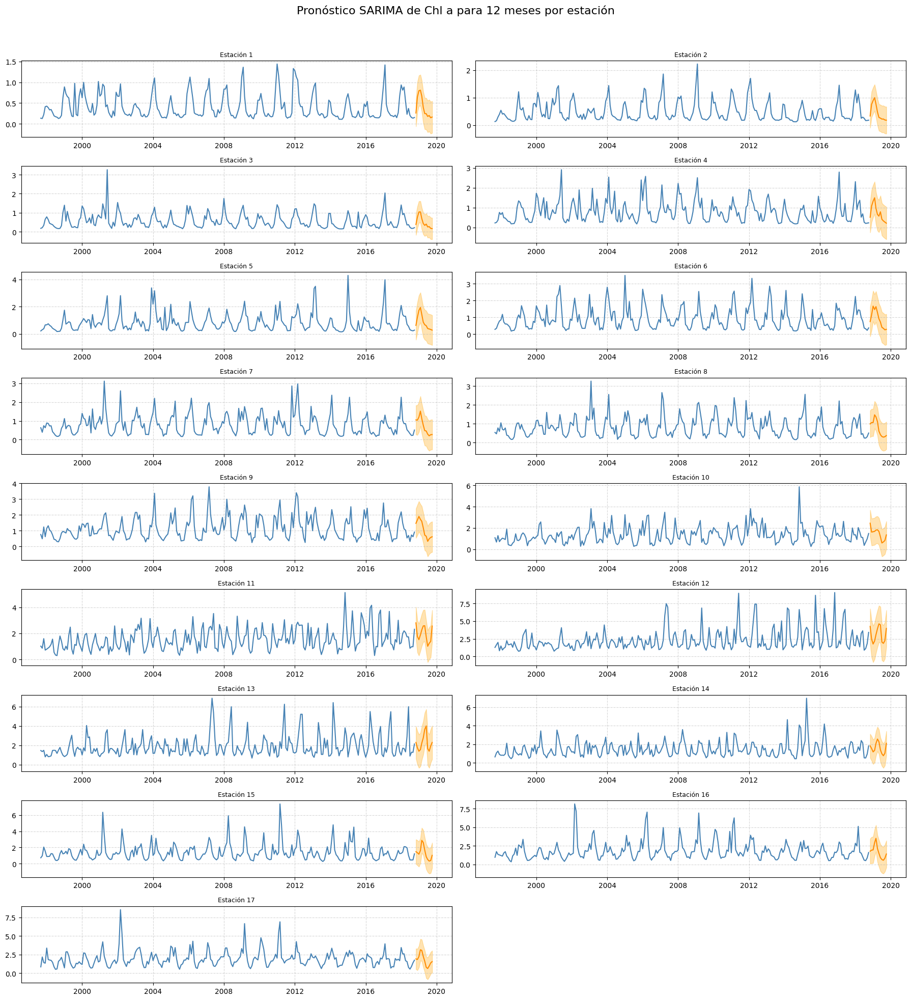

In [56]:
fig, axes = plt.subplots(nrows=9, ncols=2, figsize=(18, 20), sharex=False)
axes = axes.flatten()

for i, est in enumerate(sorted(forecast_dict.keys())):
    ax = axes[i]
    datos = forecast_dict[est]
    fechas_pred = datos["pred"].index.to_pydatetime()

    ci_inf = datos["ci_inf"].astype(float).values
    ci_sup = datos["ci_sup"].astype(float).values
    pred = datos["pred"].astype(float).values

    ax.plot(datos["observado"], label="Observado", color="steelblue")
    ax.plot(fechas_pred, pred, label="Predicción", color="darkorange")
    ax.fill_between(fechas_pred, ci_inf, ci_sup, color="orange", alpha=0.3)
    ax.set_title(f"Estación {est}", fontsize=9)
    ax.grid(True, linestyle='--', alpha=0.5)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])  # eliminar ejes sobrantes si no se usan

fig.suptitle("Pronóstico SARIMA de Chl a para 12 meses por estación", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [57]:
# Crear mapa
m = folium.Map(location=[26, -111], zoom_start=6, tiles="CartoDB positron")
marker_cluster = MarkerCluster().add_to(m)

# Generar marcadores con gráficos
for _, row in coords_df.iterrows():
    est = row["Estacion"]
    if est not in forecast_dict:
        continue

    datos = forecast_dict[est]
    fechas_pred = datos["pred"].index.to_pydatetime()
    ci_inf = datos["ci_inf"].astype(float).values
    ci_sup = datos["ci_sup"].astype(float).values
    pred = datos["pred"].astype(float).values

    fig, ax = plt.subplots(figsize=(8, 4))
    ax.plot(datos["observado"], label="Observado", color="steelblue")
    ax.plot(fechas_pred, pred, label="Predicción", color="darkorange")
    ax.fill_between(fechas_pred, ci_inf, ci_sup, color="orange", alpha=0.3)
    ax.set_title(f"Pronóstico SARIMA de Chl a para 12 meses - Estación {est}", fontsize=10)
    ax.tick_params(labelsize=8)
    ax.grid(True, linestyle="--", alpha=0.5)
    plt.tight_layout()

    img = BytesIO()
    plt.savefig(img, format="png")
    plt.close(fig)
    img.seek(0)
    encoded = base64.b64encode(img.read()).decode("utf-8")
    html = f'<img src="data:image/png;base64,{encoded}">'
    iframe = folium.IFrame(html, width=850, height=420)

    folium.Marker(
        location=[row["Latitud"], row["Longitud"]],
        popup=folium.Popup(iframe),
        tooltip=f"Estación {est}"
    ).add_to(marker_cluster)

m

In [59]:
# Paso 1: Calcular climatología mensual local
chla_long["Mes"] = chla_long["FECHA"].dt.month
climatologia_local = chla_long.groupby(["Estacion", "Mes"])["Chla"].mean().reset_index()
climatologia_local.columns = ["Estacion", "Mes", "Chla_media"]

# Paso 2: Calcular anomalías
chla_long["Mes"] = chla_long["FECHA"].dt.month
chla_anom = pd.merge(chla_long, climatologia_local, on=["Estacion", "Mes"], how="left")
chla_anom["Anomalia"] = chla_anom["Chla"] - chla_anom["Chla_media"]

# Paso 3: Promediar anomalías mensuales entre todas las estaciones
anom_media_mensual = chla_anom.groupby("FECHA")["Anomalia"].mean().reset_index()
anom_media_mensual["ENSO_clasif"] = anom_media_mensual["Anomalia"].apply(
    lambda x: "Niño" if x >= 0.5 else ("Niña" if x <= -0.5 else "Neutro")
)

# Paso 4: Unir con Chla total (histórica + predicción)
chla_filtered = chla_long[(chla_long["FECHA"] >= "2010-01-01")].copy()

# Agregar predicciones a cada estación para 2024
future_data = []

for est, datos in forecast_dict.items():
    fechas_pred = datos["pred"].index
    for fecha, valor in zip(fechas_pred, datos["pred"]):
        future_data.append({
            "FECHA": fecha,
            "Estacion": est,
            "Chla": valor
        })

future_df = pd.DataFrame(future_data)
future_df["FECHA"] = pd.to_datetime(future_df["FECHA"])

# Unir históricos y futuros
chla_combined = pd.concat([
    chla_filtered[["FECHA", "Estacion", "Chla"]],
    future_df
], ignore_index=True)

# Agregar coordenadas
chla_geo = pd.merge(chla_combined, coords_df, on="Estacion", how="left")

# Redondear fechas al primer día del mes
chla_geo["FECHA"] = pd.to_datetime(chla_geo["FECHA"]).dt.to_period("M").dt.to_timestamp()

# Unir clasificación ENSO basada en chla local
chla_geo = pd.merge(chla_geo, anom_media_mensual, on="FECHA", how="left")

# Normalizar chla
chla_min = chla_geo["Chla"].min()
chla_max = chla_geo["Chla"].max()
chla_geo["Chla_norm"] = (chla_geo["Chla"] - chla_min) / (chla_max - chla_min)

# Función de color
from matplotlib import cm
def color_scale(chla):
    rgba = cm.inferno(chla)
    return f"rgba({int(rgba[0]*255)}, {int(rgba[1]*255)}, {int(rgba[2]*255)}, 0.8)"

# Crear geojson interactivo
features = []
for _, row in chla_geo.iterrows():
    popup_text = f"""
    <b>Estación {row['Estacion']}</b><br>
    Fecha: {row['FECHA'].strftime('%Y-%m')}<br>
    Chla: {row['Chla']:.2f}<br>
    ENSO: {row['ENSO_clasif']}
    """
    feature = {
        "type": "Feature",
        "geometry": {
            "type": "Point",
            "coordinates": [row["Longitud"], row["Latitud"]]
        },
        "properties": {
            "time": row["FECHA"].strftime("%Y-%m-%dT%H:%M:%S"),
            "style": {
                "color": color_scale(row["Chla_norm"]),
                "fillColor": color_scale(row["Chla_norm"]),
                "fillOpacity": 0.7,
                "radius": 6
            },
            "icon": "circle",
            "popup": popup_text
        }
    }
    features.append(feature)

geojson = {
    "type": "FeatureCollection",
    "features": features
}

# Crear mapa
import folium
from folium.plugins import TimestampedGeoJson

m = folium.Map(location=[26, -111], zoom_start=6, tiles="CartoDB positron")
TimestampedGeoJson(
    data=geojson,
    transition_time=300,
    period="P1M",
    add_last_point=True,
    loop=False,
    auto_play=True,
    max_speed=1,
    loop_button=True,
    date_options='YYYY-MM',
    time_slider_drag_update=True
).add_to(m)

m